In [1]:
# Step 1: Import Libraries and Set Device
import torch                            # Core PyTorch library
from torch import nn                    # Neural network modules
from torch.utils.data import DataLoader  # Efficient batch loading
from torchvision import datasets, transforms  # To load and transform image data
from torchvision.utils import make_grid  # For grid visualization of tensors
import matplotlib.pyplot as plt         # Plotting library
from tqdm.auto import tqdm              # Progress bar

# Automatically choose GPU if available, else fall back to CPU
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

Using device: cuda


In [2]:
# Step 2: Load Fashion MNIST Dataset and Normalize
transform = transforms.Compose([
    transforms.ToTensor(),                    # Converts image to tensor in range [0,1]
    transforms.Normalize((0.5,), (0.5,))      # Rescales it to [-1, 1] for Tanh output compatibility
])

dataloader = DataLoader(
    datasets.FashionMNIST(root='.', download=True, transform=transform),
    batch_size=128,                         # Number of images per batch
    shuffle=True                            # Shuffle data to reduce learning bias
)


In [3]:
# Step 3: Noise Generator Function
def get_noise(n_samples, z_dim, device='cpu'):
    return torch.randn(n_samples, z_dim, device=device)  # Standard normal noise input to generator


In [4]:
# Step 4: Define Generator Network
class Generator(nn.Module):
    def __init__(self, z_dim=64, im_chan=1, hidden_dim=64):
        super().__init__()
        self.z_dim = z_dim
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh()  # Output in [-1, 1] range
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.z_dim, 1, 1)  # Reshape noise to match ConvTranspose2D input
        return self.gen(x)


In [5]:
# Step 5: Define Critic Network (like Discriminator)
class Critic(nn.Module):
    def __init__(self, im_chan=1, hidden_dim=64):
        super().__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True)
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride)
            )

    def forward(self, image):
        return self.crit(image).view(len(image), -1)  # Flatten for W-loss


In [6]:
 #Step 6: Gradient Penalty Calculations

def get_gradient(crit, real, fake, epsilon):
    mixed_images = real * epsilon + fake * (1 - epsilon)  # Interpolation between real and fake
    mixed_scores = crit(mixed_images)
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]  # Return gradients w.r.t mixed images
    return gradient

def gradient_penalty(gradient):
    gradient = gradient.view(len(gradient), -1)     # Flatten
    gradient_norm = gradient.norm(2, dim=1)         # L2 norm
    return ((gradient_norm - 1) ** 2).mean()        # Penalize deviation from 

In [7]:
# Step 7: WGAN Loss Functions
def get_gen_loss(crit_fake_pred):
    return -torch.mean(crit_fake_pred)  # Generator wants fake scores to be high

def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    wasserstein = torch.mean(crit_real_pred) - torch.mean(crit_fake_pred)
    return -wasserstein + c_lambda * gp


In [8]:
# Step 8: Hyperparameters for Training
z_dim = 64                # Size of noise vector
lr = 2e-4                 # Learning rate
batch_size = 128          
n_epochs = 200            # Number of full passes through dataset
display_step = 500        # Plot every n steps
beta_1, beta_2 = 0.5, 0.999  # Adam optimizer betas
c_lambda = 10             # Weight for gradient penalty
crit_repeats = 5          # Number of critic updates per generator update

In [9]:
# Step 9: Model & Optimizer Setup
gen = Generator(z_dim).to(device)
crit = Critic().to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

In [10]:
# Step 10: Visualize Output Images
def show_tensor_images(image_tensor, num_images=25):
    image_tensor = (image_tensor + 1) / 2  # Rescale to [0,1]
    image_grid = make_grid(image_tensor[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).cpu().squeeze())
    plt.axis("off")
    plt.show()

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 1 Step 500: Gen Loss: 1.6659, Crit Loss: -2.2615


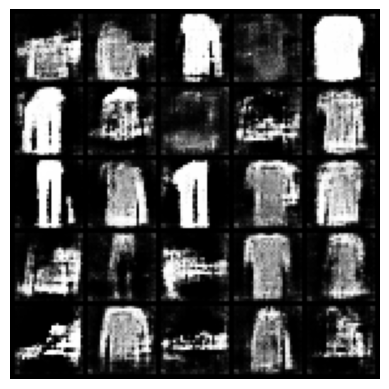

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 2 Step 1000: Gen Loss: 2.3717, Crit Loss: -1.9343


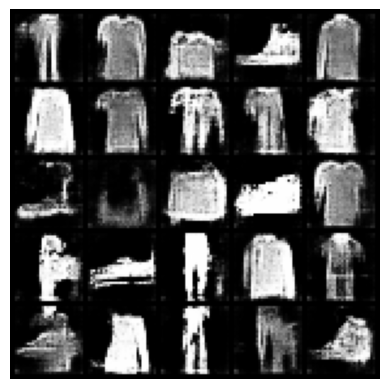

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 3 Step 1500: Gen Loss: 1.8554, Crit Loss: -1.4650


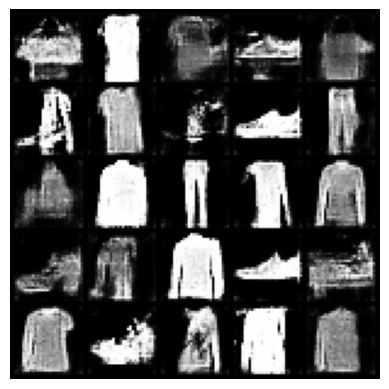

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 4 Step 2000: Gen Loss: 2.5845, Crit Loss: -1.2379


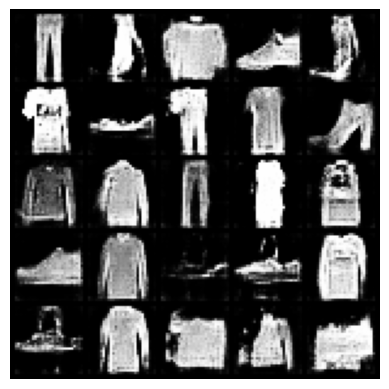

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 5 Step 2500: Gen Loss: 3.4028, Crit Loss: -1.4828


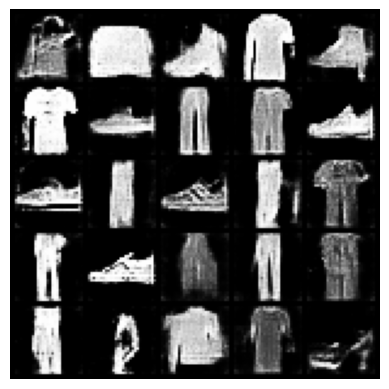

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 6 Step 3000: Gen Loss: 1.5432, Crit Loss: -1.3154


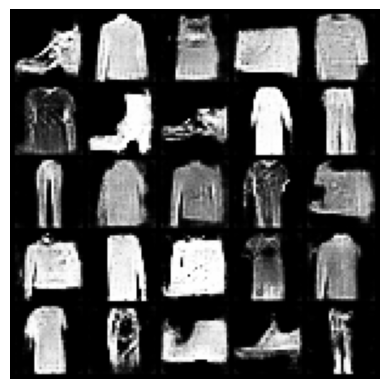

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 7 Step 3500: Gen Loss: 2.7872, Crit Loss: -0.9311


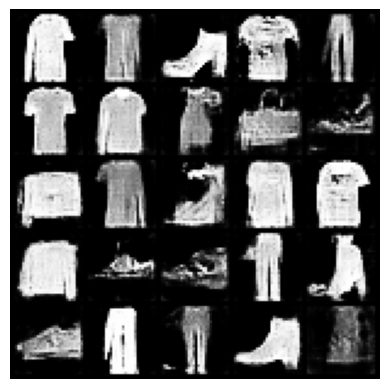

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 8 Step 4000: Gen Loss: 1.9254, Crit Loss: -1.2603


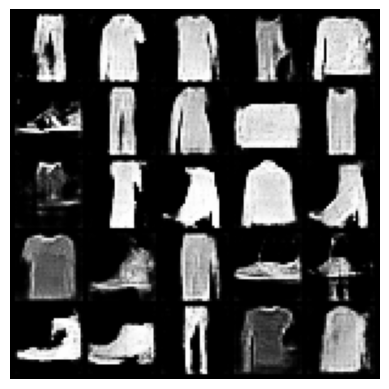

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 9 Step 4500: Gen Loss: 2.9237, Crit Loss: -0.9443


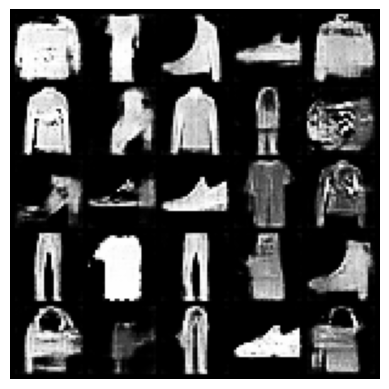

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 10 Step 5000: Gen Loss: 4.1980, Crit Loss: -0.6583


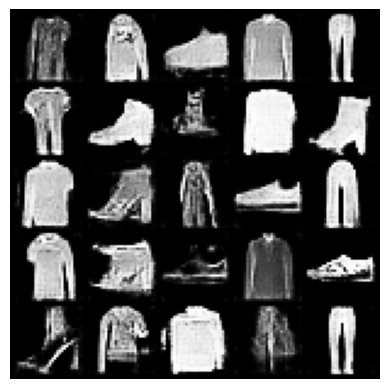

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 11 Step 5500: Gen Loss: 3.5179, Crit Loss: -0.9875


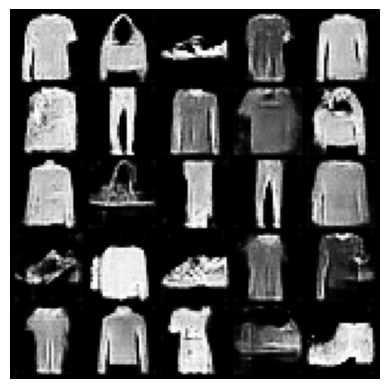

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 12 Step 6000: Gen Loss: 4.1957, Crit Loss: -0.7804


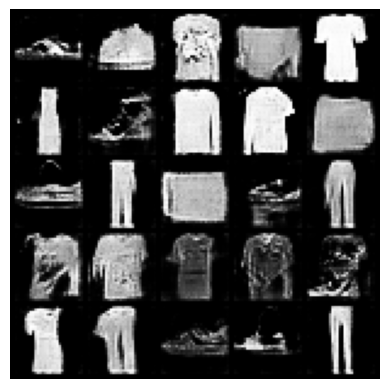

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 13 Step 6500: Gen Loss: 3.0360, Crit Loss: -1.0813


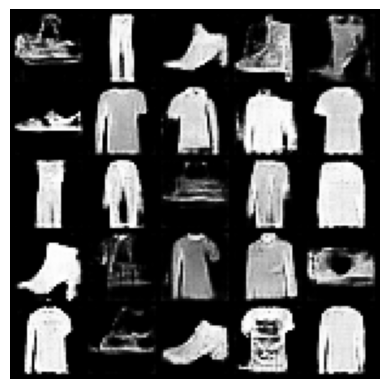

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 14 Step 7000: Gen Loss: 4.2916, Crit Loss: -0.7385


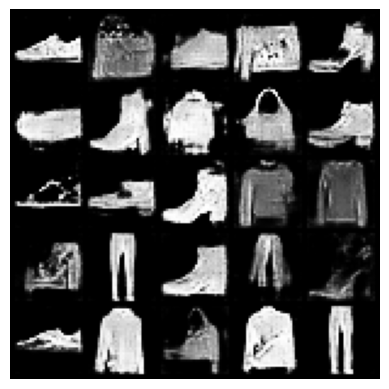

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 15 Step 7500: Gen Loss: 4.4344, Crit Loss: -1.0282


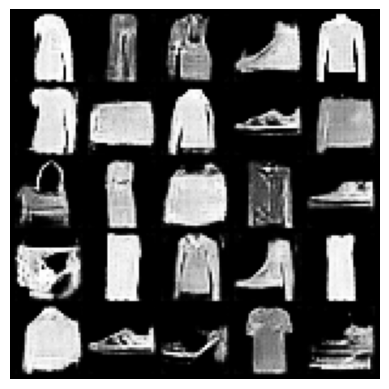

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 17 Step 8000: Gen Loss: 4.8131, Crit Loss: -1.0046


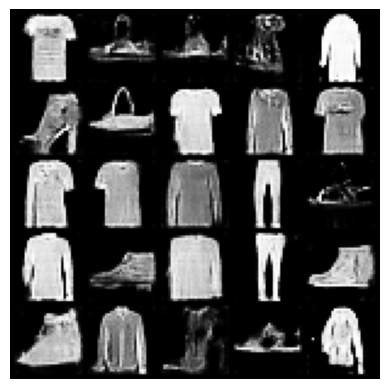

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 18 Step 8500: Gen Loss: 5.2950, Crit Loss: -0.7892


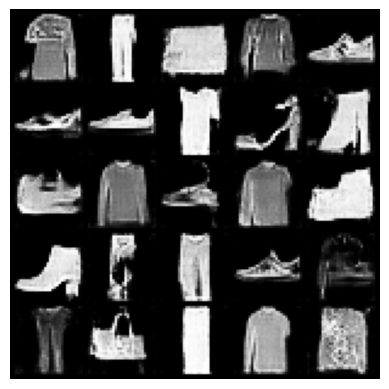

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 19 Step 9000: Gen Loss: 4.4069, Crit Loss: -0.8105


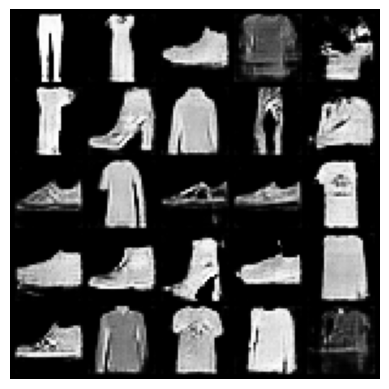

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 20 Step 9500: Gen Loss: 6.2095, Crit Loss: -1.1352


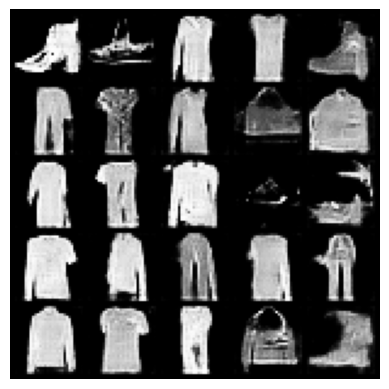

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 21 Step 10000: Gen Loss: 4.7856, Crit Loss: -0.2960


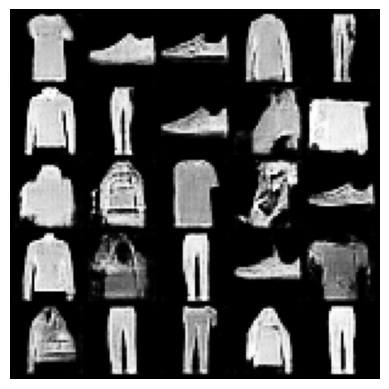

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 22 Step 10500: Gen Loss: 4.3430, Crit Loss: -0.5738


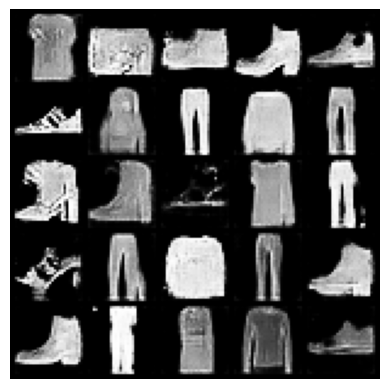

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 23 Step 11000: Gen Loss: 4.5263, Crit Loss: -0.3398


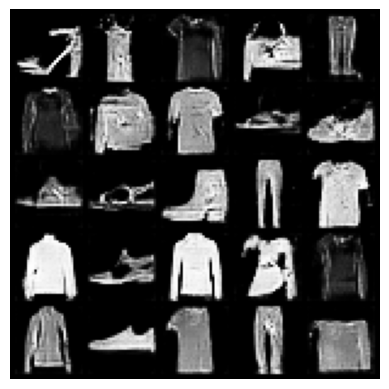

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 24 Step 11500: Gen Loss: 2.8613, Crit Loss: -0.7060


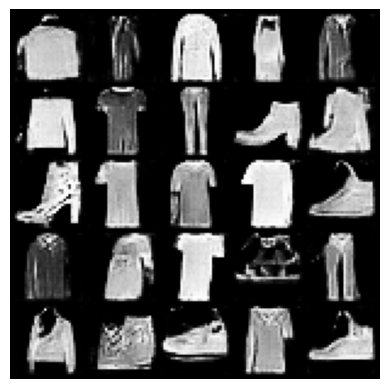

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 25 Step 12000: Gen Loss: 3.5367, Crit Loss: -1.0970


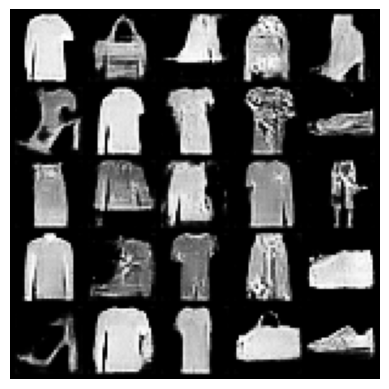

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 26 Step 12500: Gen Loss: 5.5837, Crit Loss: -0.6393


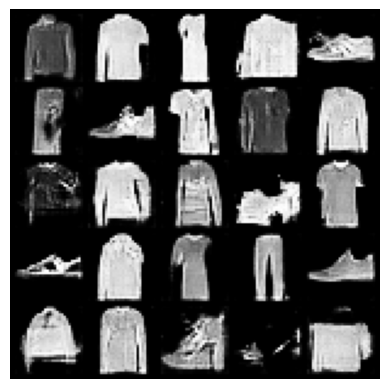

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 27 Step 13000: Gen Loss: 4.6538, Crit Loss: -0.8975


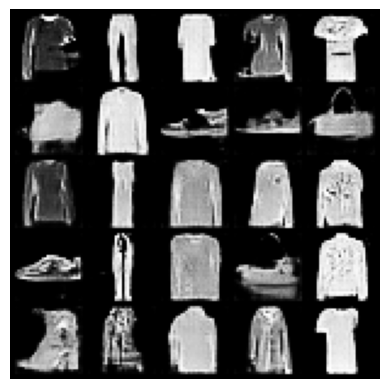

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 28 Step 13500: Gen Loss: 3.5338, Crit Loss: -0.6358


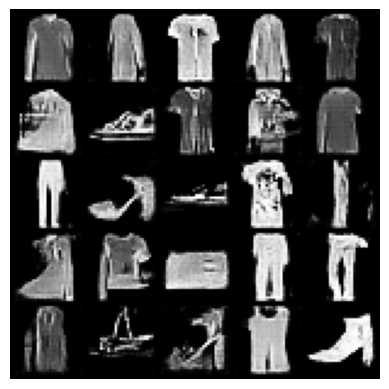

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 29 Step 14000: Gen Loss: 3.7891, Crit Loss: -0.8106


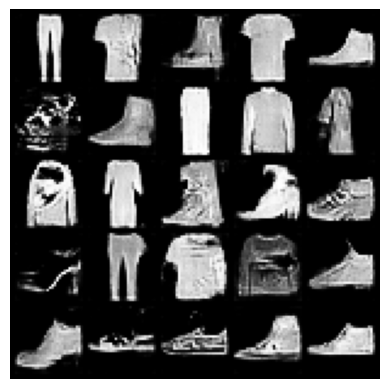

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 30 Step 14500: Gen Loss: 4.5389, Crit Loss: -0.9561


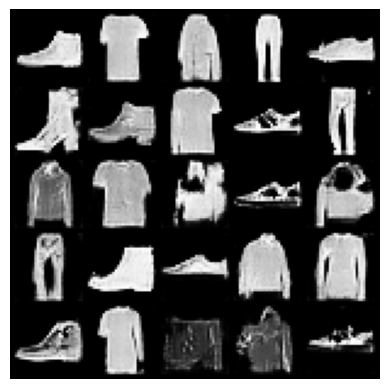

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 31 Step 15000: Gen Loss: 4.3461, Crit Loss: -0.4754


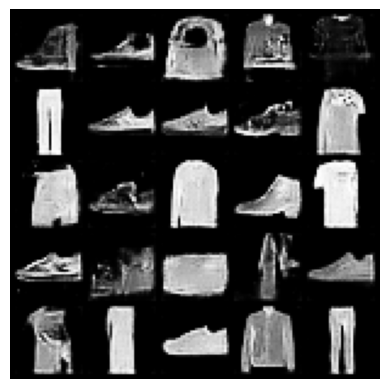

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 33 Step 15500: Gen Loss: 3.4352, Crit Loss: -0.5683


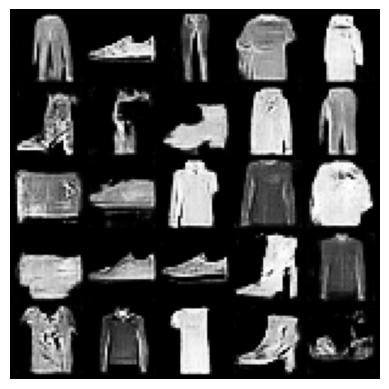

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 34 Step 16000: Gen Loss: 4.1635, Crit Loss: -0.3761


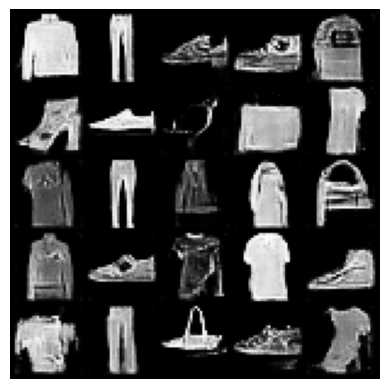

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 35 Step 16500: Gen Loss: 4.9901, Crit Loss: -0.4124


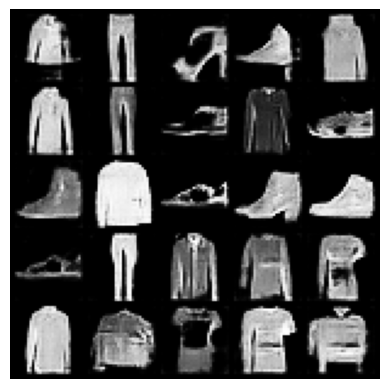

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 36 Step 17000: Gen Loss: 5.3581, Crit Loss: -0.5715


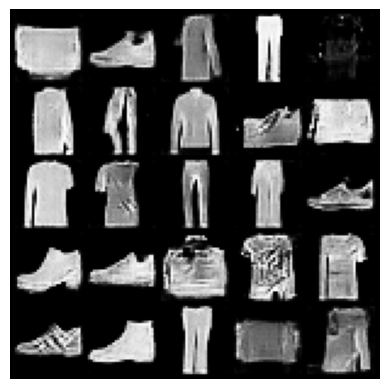

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 37 Step 17500: Gen Loss: 3.3521, Crit Loss: -0.6802


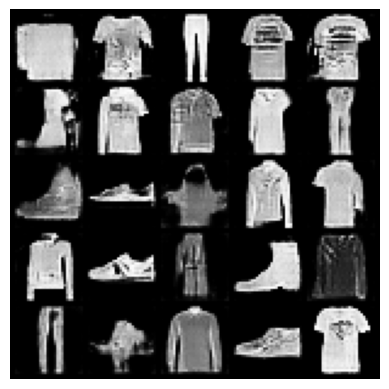

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 38 Step 18000: Gen Loss: 4.7743, Crit Loss: -0.3468


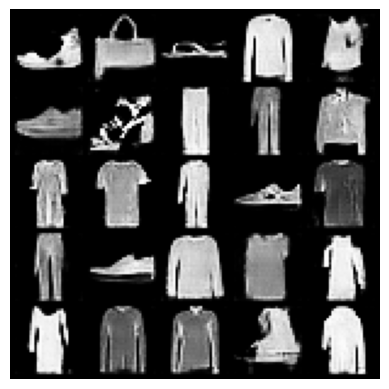

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 39 Step 18500: Gen Loss: 3.0508, Crit Loss: -0.3528


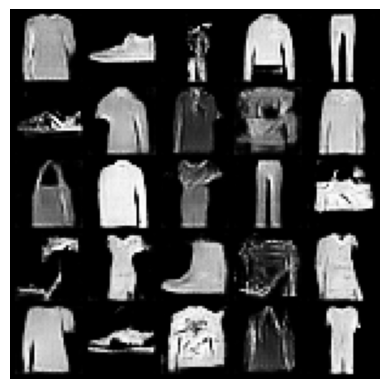

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 40 Step 19000: Gen Loss: 7.5834, Crit Loss: -0.5234


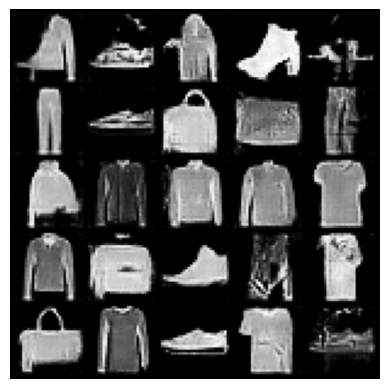

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 41 Step 19500: Gen Loss: 5.8740, Crit Loss: -0.2953


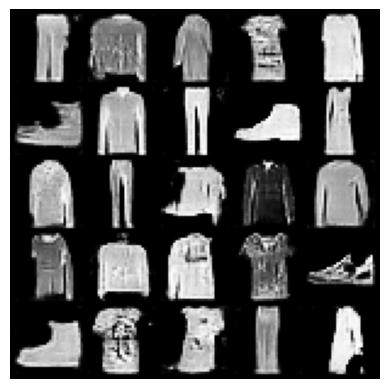

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 42 Step 20000: Gen Loss: 4.4278, Crit Loss: -0.5481


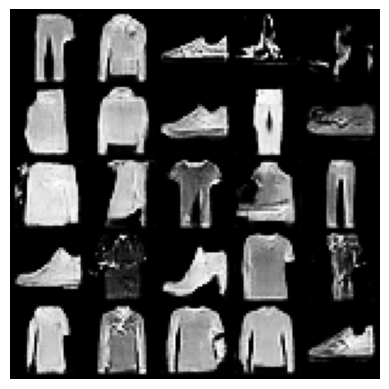

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 43 Step 20500: Gen Loss: 5.3717, Crit Loss: -0.5100


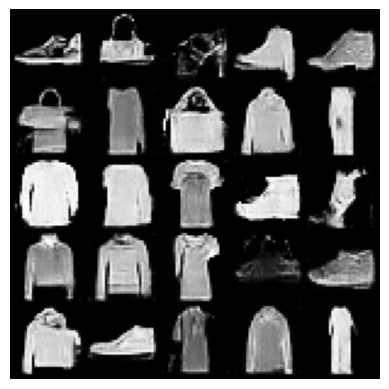

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 44 Step 21000: Gen Loss: 5.2500, Crit Loss: -0.1598


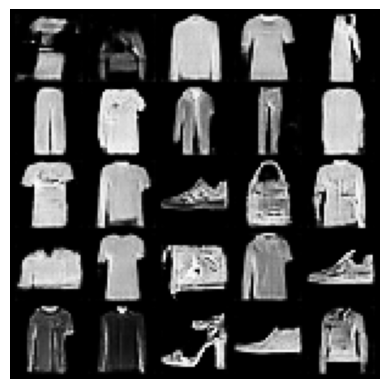

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 45 Step 21500: Gen Loss: 5.0090, Crit Loss: -0.5752


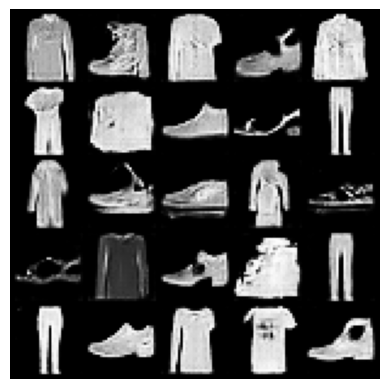

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 46 Step 22000: Gen Loss: 6.2714, Crit Loss: -1.0396


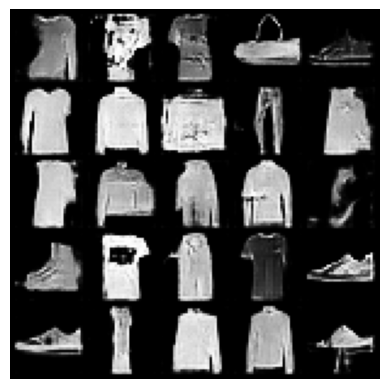

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 47 Step 22500: Gen Loss: 6.7112, Crit Loss: -0.4310


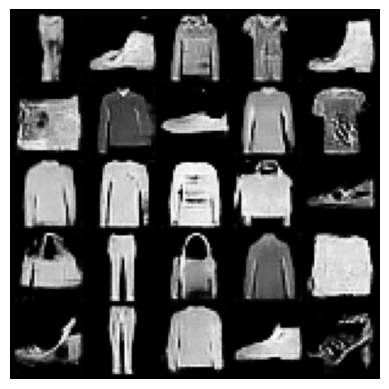

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 49 Step 23000: Gen Loss: 5.4038, Crit Loss: -0.9297


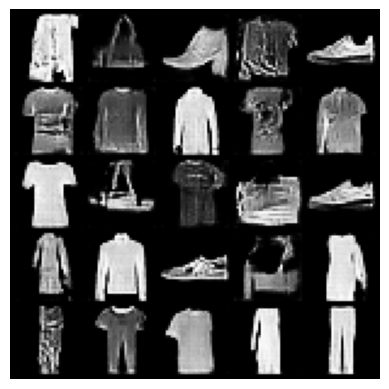

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 50 Step 23500: Gen Loss: 3.6356, Crit Loss: -0.3429


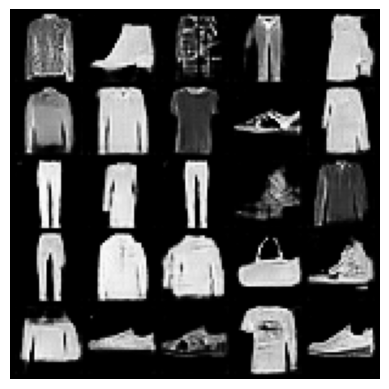

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 51 Step 24000: Gen Loss: 4.8731, Crit Loss: -0.2607


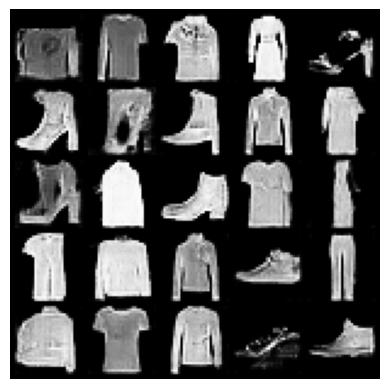

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 52 Step 24500: Gen Loss: 3.9415, Crit Loss: -0.3674


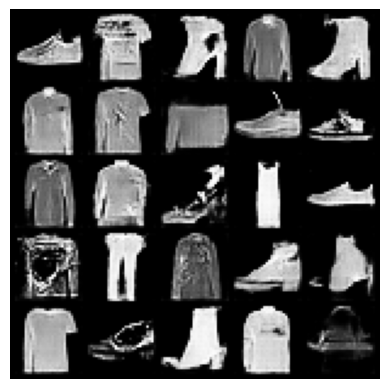

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 53 Step 25000: Gen Loss: 5.0833, Crit Loss: -0.4076


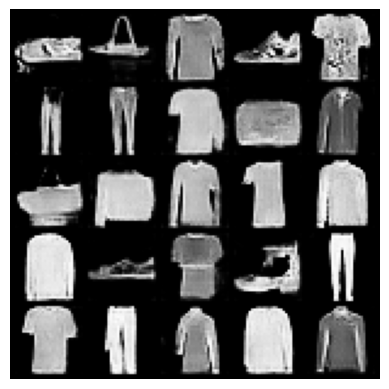

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 54 Step 25500: Gen Loss: 3.4241, Crit Loss: -0.4969


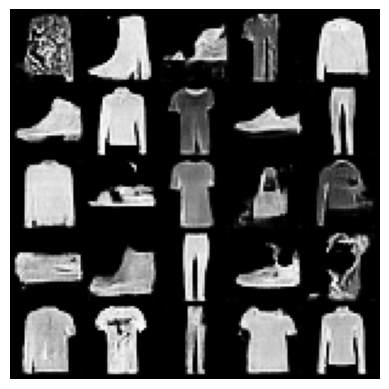

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 55 Step 26000: Gen Loss: 4.8752, Crit Loss: -0.6781


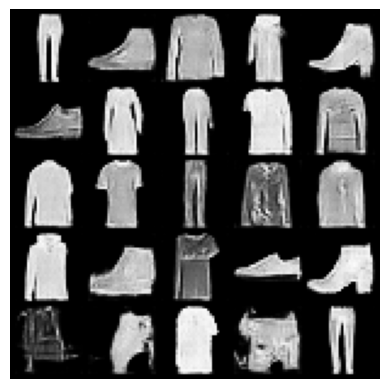

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 56 Step 26500: Gen Loss: 5.2578, Crit Loss: -0.7922


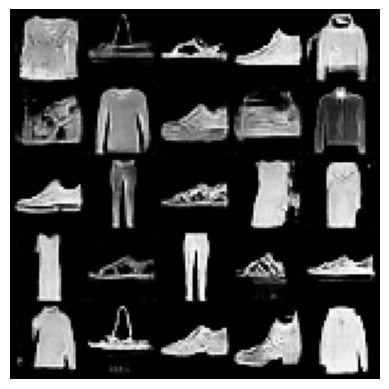

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 57 Step 27000: Gen Loss: 5.8331, Crit Loss: -0.6531


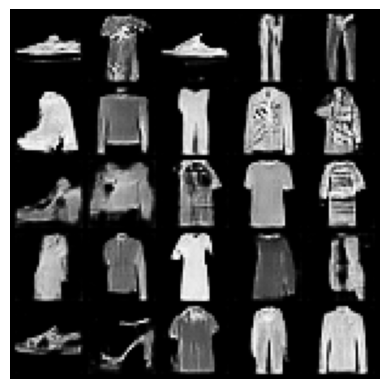

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 58 Step 27500: Gen Loss: 5.5443, Crit Loss: -0.4697


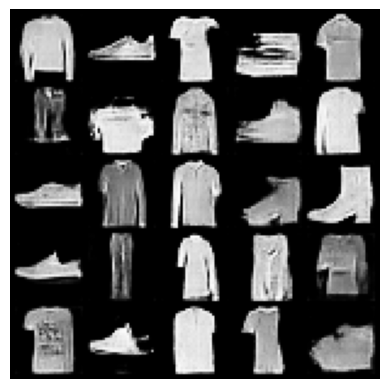

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 59 Step 28000: Gen Loss: 4.8097, Crit Loss: -0.4060


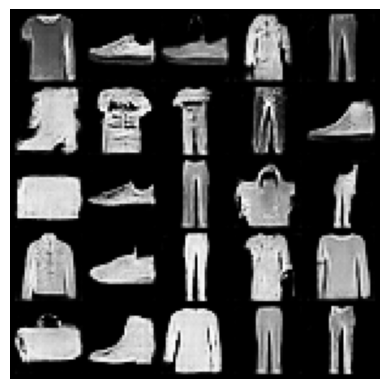

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 60 Step 28500: Gen Loss: 5.1372, Crit Loss: -0.6327


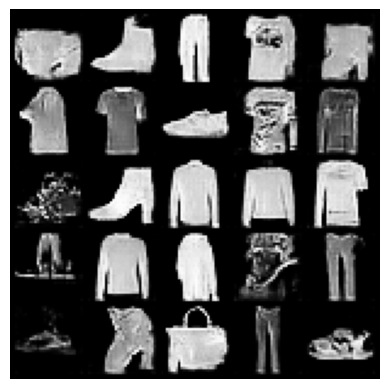

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 61 Step 29000: Gen Loss: 6.0861, Crit Loss: -0.4797


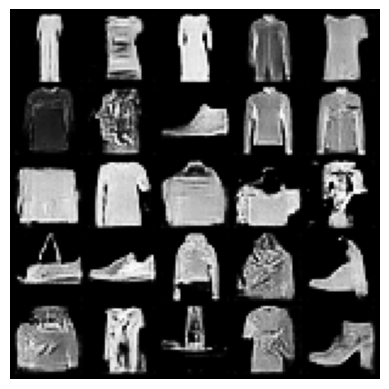

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 62 Step 29500: Gen Loss: 7.0319, Crit Loss: -0.5076


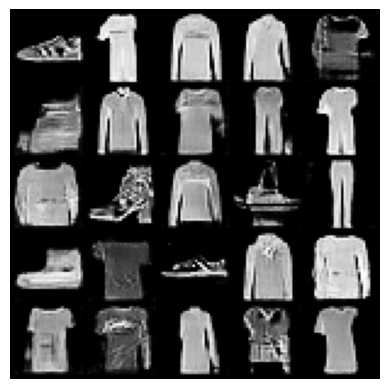

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 63 Step 30000: Gen Loss: 7.9699, Crit Loss: -0.9851


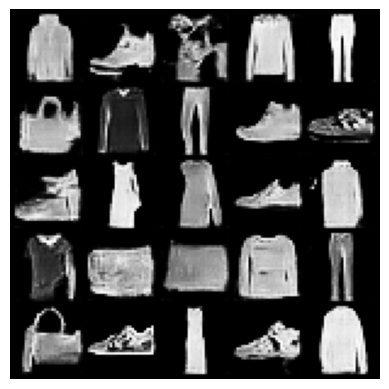

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 65 Step 30500: Gen Loss: 4.6716, Crit Loss: -0.3425


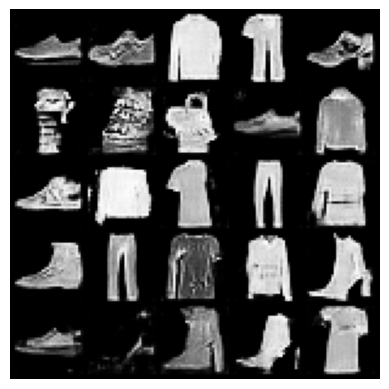

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 66 Step 31000: Gen Loss: 3.2862, Crit Loss: 0.1362


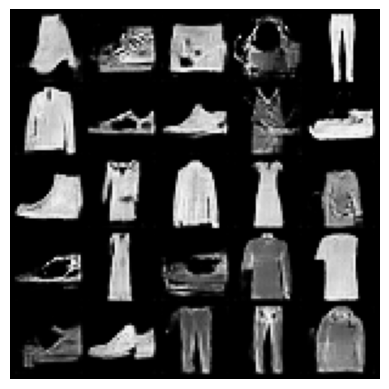

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 67 Step 31500: Gen Loss: 4.6111, Crit Loss: -0.3462


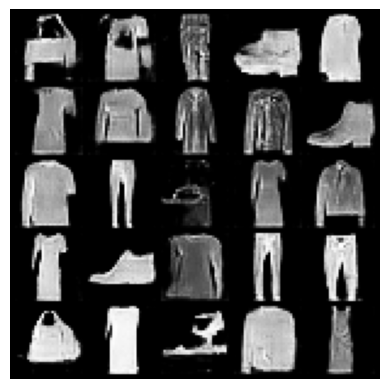

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 68 Step 32000: Gen Loss: 6.5200, Crit Loss: -0.8038


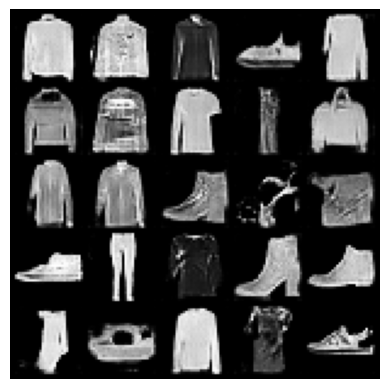

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 69 Step 32500: Gen Loss: 4.6836, Crit Loss: -1.6939


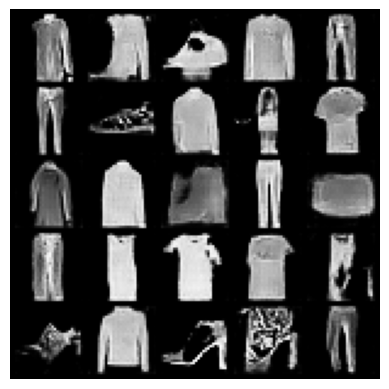

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 70 Step 33000: Gen Loss: 4.7619, Crit Loss: -0.4847


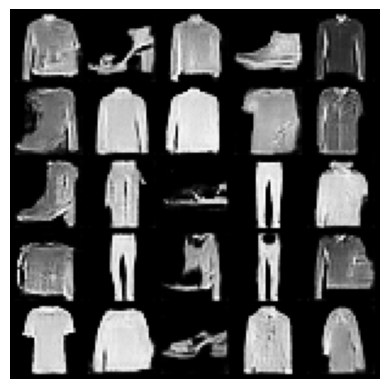

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 71 Step 33500: Gen Loss: 4.0062, Crit Loss: -0.1290


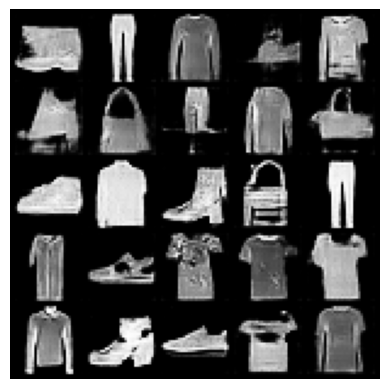

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 72 Step 34000: Gen Loss: 5.0711, Crit Loss: -0.3437


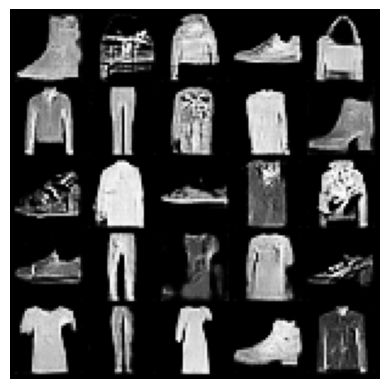

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 73 Step 34500: Gen Loss: 4.0064, Crit Loss: 0.4825


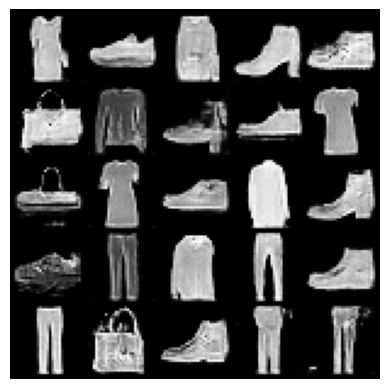

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 74 Step 35000: Gen Loss: 5.0106, Crit Loss: -0.5427


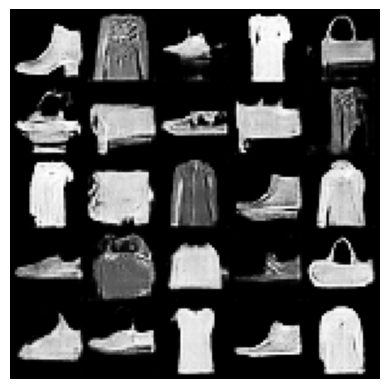

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 75 Step 35500: Gen Loss: 4.4700, Crit Loss: -0.6397


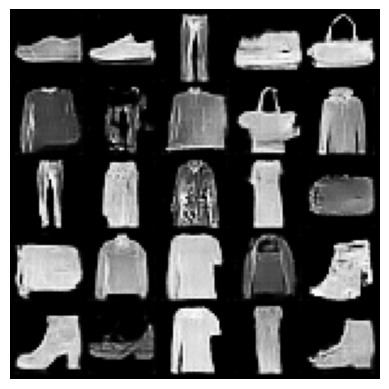

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 76 Step 36000: Gen Loss: 7.3876, Crit Loss: -2.5432


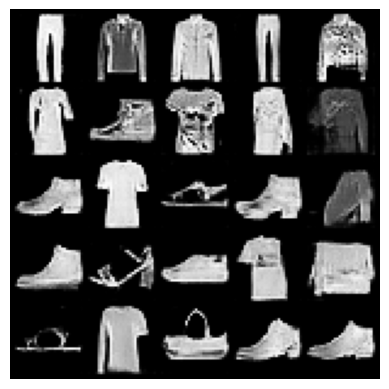

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 77 Step 36500: Gen Loss: 3.6752, Crit Loss: -1.0381


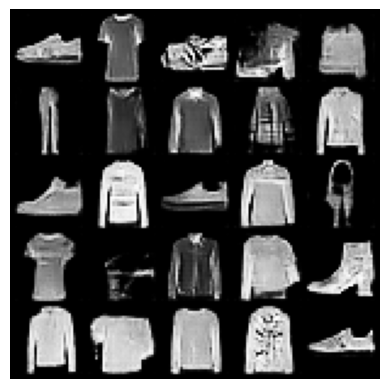

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 78 Step 37000: Gen Loss: 3.7295, Crit Loss: -0.6615


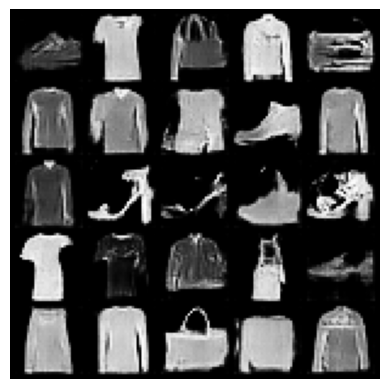

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 79 Step 37500: Gen Loss: 3.9708, Crit Loss: -0.4654


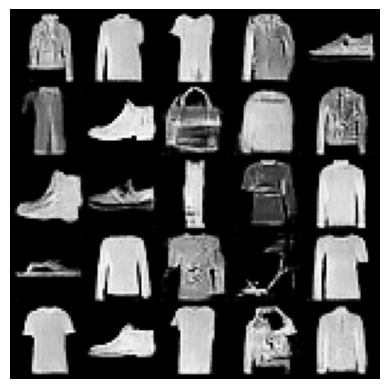

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 81 Step 38000: Gen Loss: 2.4397, Crit Loss: -0.4569


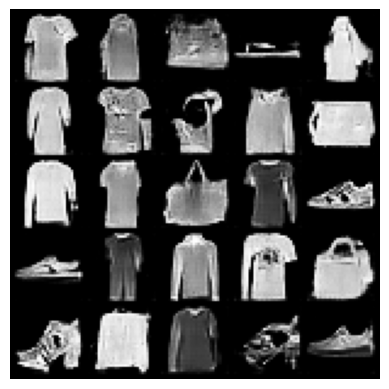

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 82 Step 38500: Gen Loss: 2.4933, Crit Loss: -0.9514


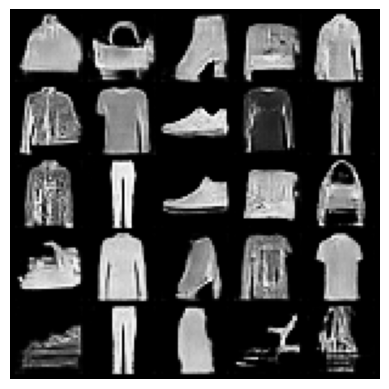

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 83 Step 39000: Gen Loss: 2.2269, Crit Loss: -0.0104


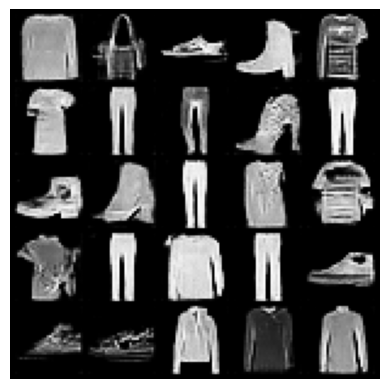

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 84 Step 39500: Gen Loss: 2.2757, Crit Loss: -2.4390


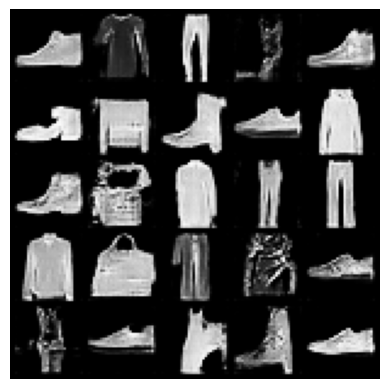

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 85 Step 40000: Gen Loss: 2.8954, Crit Loss: -0.1144


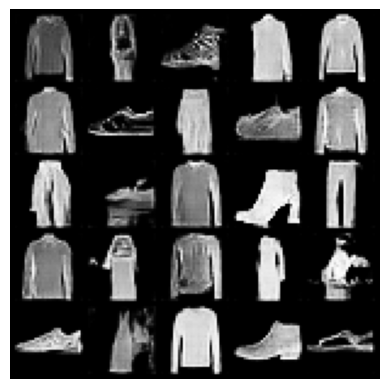

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 86 Step 40500: Gen Loss: 4.7367, Crit Loss: -0.2015


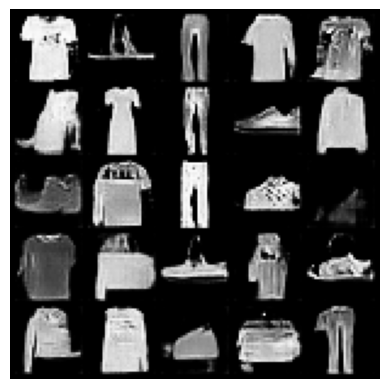

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 87 Step 41000: Gen Loss: 3.8786, Crit Loss: 0.5974


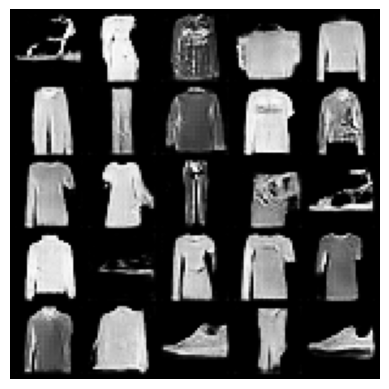

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 88 Step 41500: Gen Loss: 4.8122, Crit Loss: 0.0459


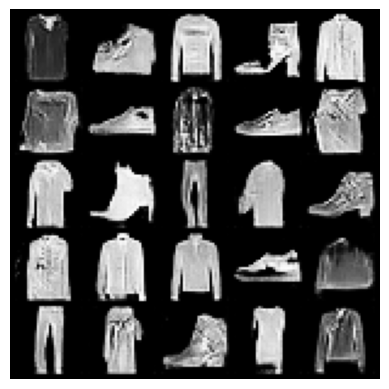

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 89 Step 42000: Gen Loss: 4.4719, Crit Loss: -1.0249


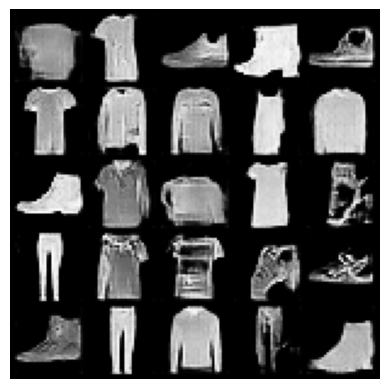

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 90 Step 42500: Gen Loss: 3.0479, Crit Loss: -2.0765


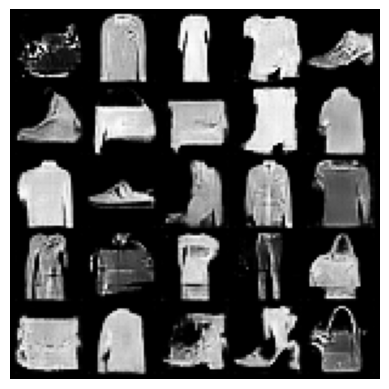

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 91 Step 43000: Gen Loss: 2.7392, Crit Loss: -0.9021


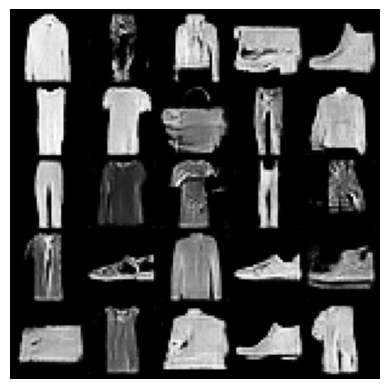

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 92 Step 43500: Gen Loss: 4.4099, Crit Loss: -1.0082


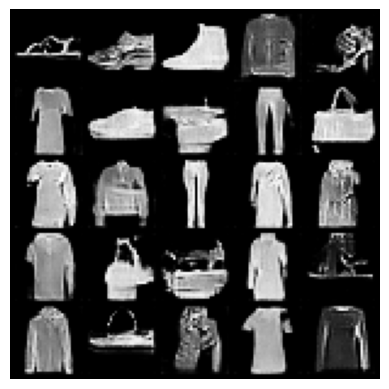

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 93 Step 44000: Gen Loss: -0.3237, Crit Loss: -4.3274


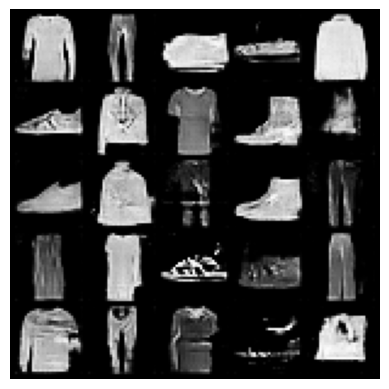

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 94 Step 44500: Gen Loss: 2.9284, Crit Loss: -0.2940


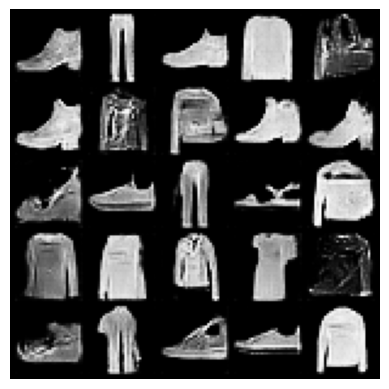

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 95 Step 45000: Gen Loss: 2.3413, Crit Loss: -2.7772


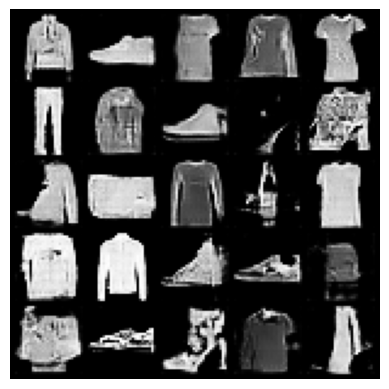

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 97 Step 45500: Gen Loss: 5.8734, Crit Loss: -0.9580


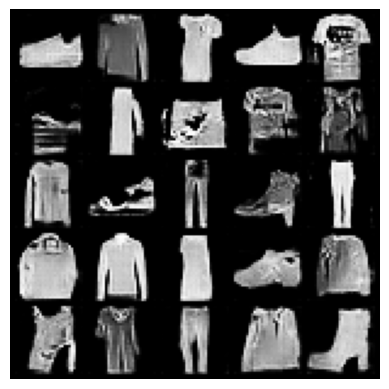

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 98 Step 46000: Gen Loss: 4.0586, Crit Loss: -0.6634


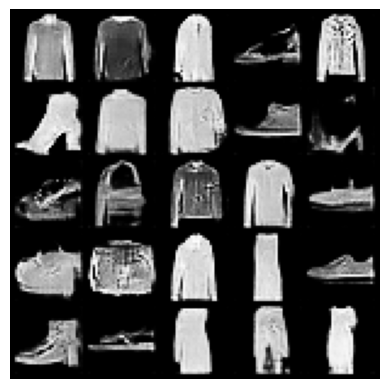

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 99 Step 46500: Gen Loss: 4.7405, Crit Loss: -0.3959


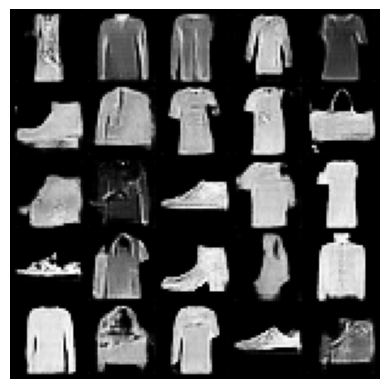

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 100 Step 47000: Gen Loss: 8.0614, Crit Loss: -1.7708


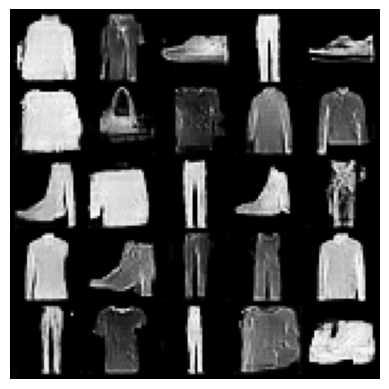

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 101 Step 47500: Gen Loss: 3.8732, Crit Loss: 0.5018


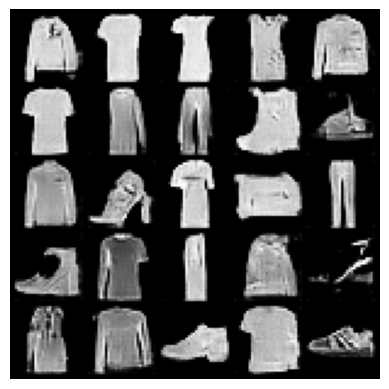

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 102 Step 48000: Gen Loss: 4.5770, Crit Loss: -0.2775


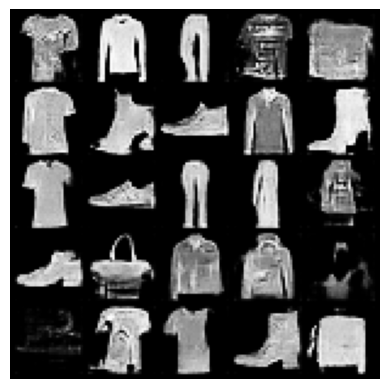

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 103 Step 48500: Gen Loss: 3.1237, Crit Loss: -1.0166


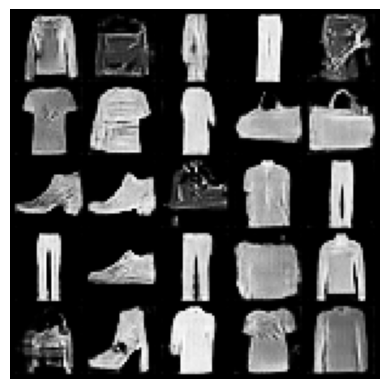

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 104 Step 49000: Gen Loss: 3.0449, Crit Loss: -0.0700


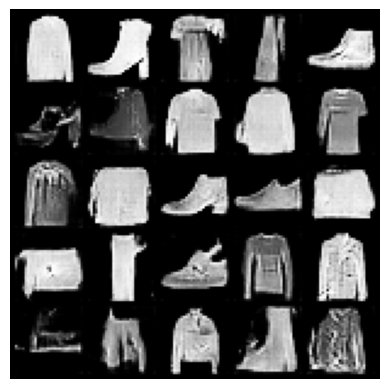

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 105 Step 49500: Gen Loss: 4.1574, Crit Loss: -0.8270


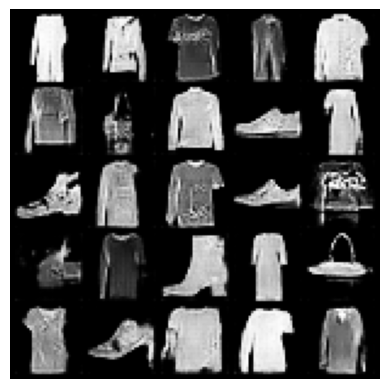

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 106 Step 50000: Gen Loss: 4.2144, Crit Loss: 0.4125


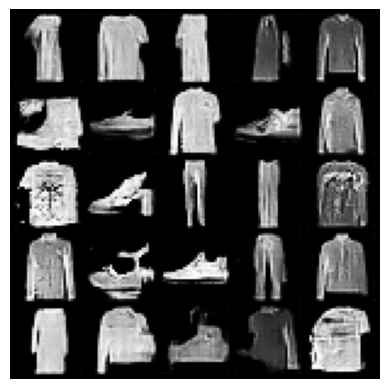

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 107 Step 50500: Gen Loss: 3.0673, Crit Loss: -0.6950


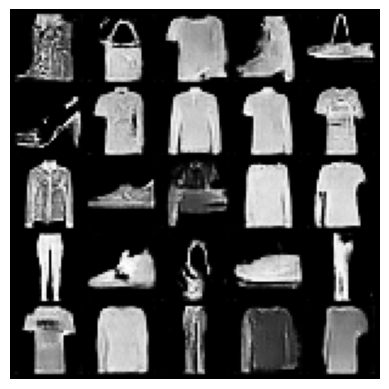

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 108 Step 51000: Gen Loss: 4.3241, Crit Loss: 1.4025


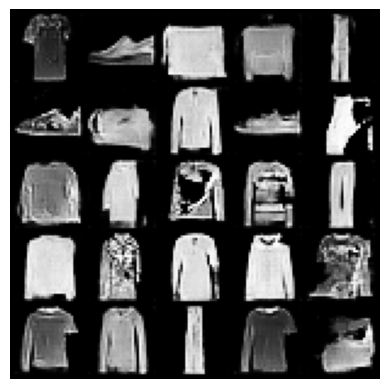

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 109 Step 51500: Gen Loss: 4.5097, Crit Loss: 0.2838


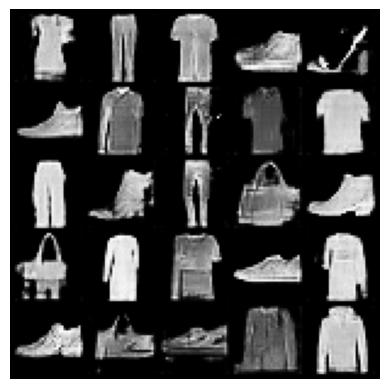

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 110 Step 52000: Gen Loss: 2.8807, Crit Loss: -0.8996


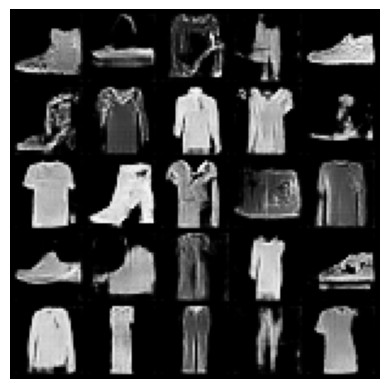

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 111 Step 52500: Gen Loss: 4.6627, Crit Loss: 0.3725


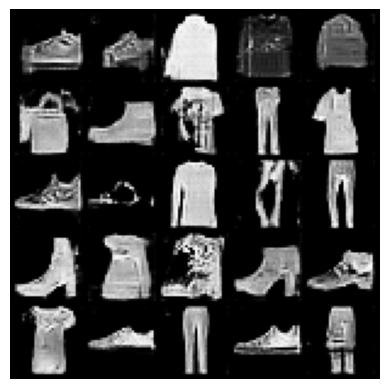

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 113 Step 53000: Gen Loss: 7.9458, Crit Loss: -1.3373


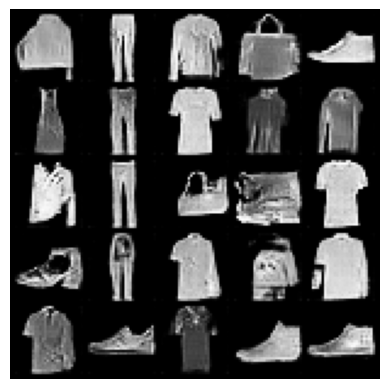

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 114 Step 53500: Gen Loss: 3.7987, Crit Loss: 0.3630


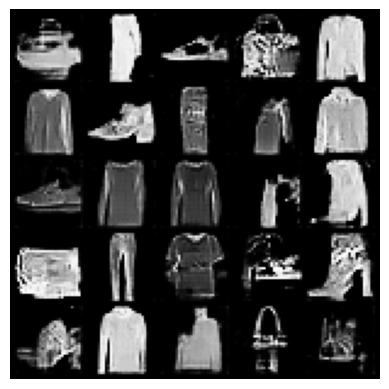

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 115 Step 54000: Gen Loss: 4.2746, Crit Loss: 0.5333


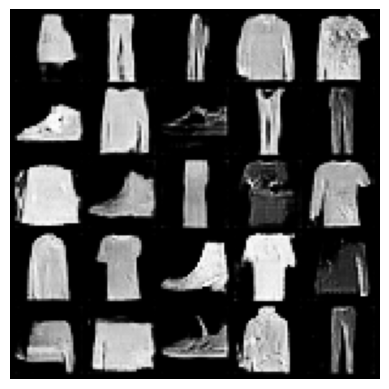

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 116 Step 54500: Gen Loss: 8.9577, Crit Loss: -1.2890


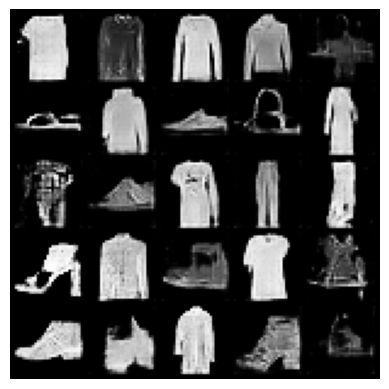

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 117 Step 55000: Gen Loss: 1.1845, Crit Loss: -1.0802


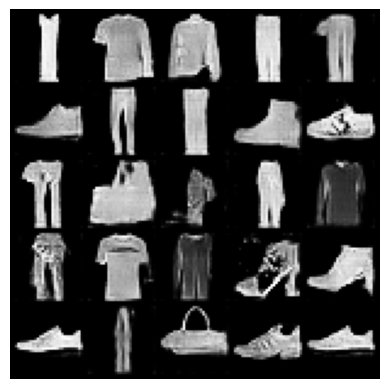

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 118 Step 55500: Gen Loss: 2.4605, Crit Loss: -0.2662


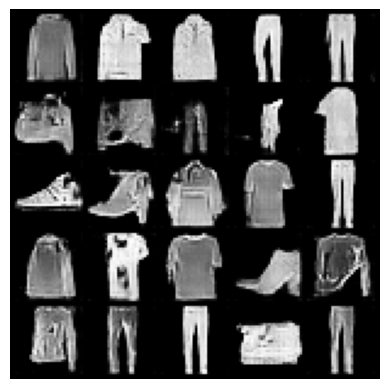

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 119 Step 56000: Gen Loss: 4.2471, Crit Loss: -0.5959


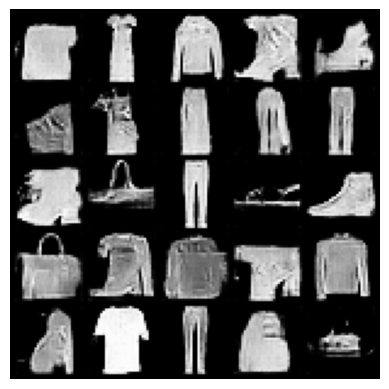

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 120 Step 56500: Gen Loss: 1.2958, Crit Loss: -0.5103


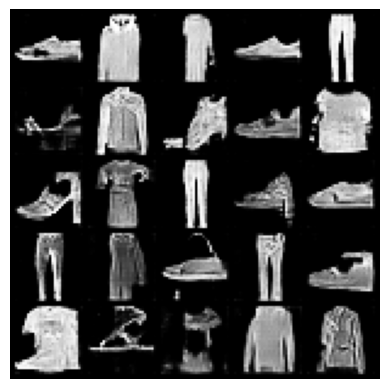

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 121 Step 57000: Gen Loss: 4.9373, Crit Loss: -0.3485


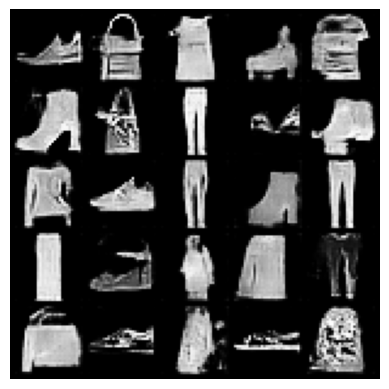

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 122 Step 57500: Gen Loss: 3.0564, Crit Loss: -0.8989


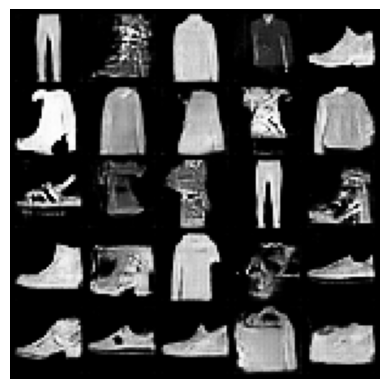

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 123 Step 58000: Gen Loss: 3.1080, Crit Loss: 0.2070


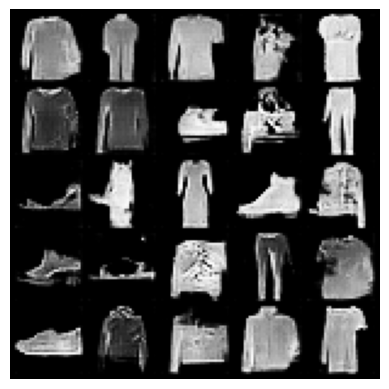

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 124 Step 58500: Gen Loss: 3.6552, Crit Loss: 1.1264


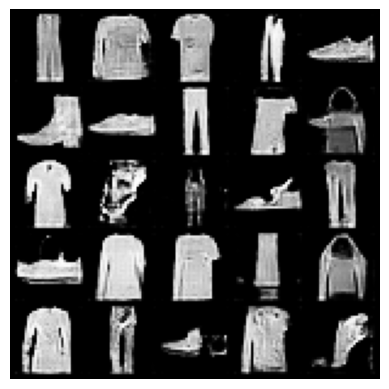

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 125 Step 59000: Gen Loss: 0.2081, Crit Loss: -4.4618


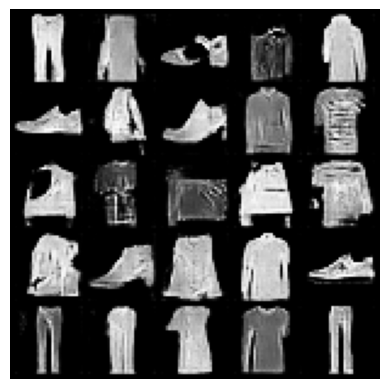

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 126 Step 59500: Gen Loss: 2.0288, Crit Loss: 0.5542


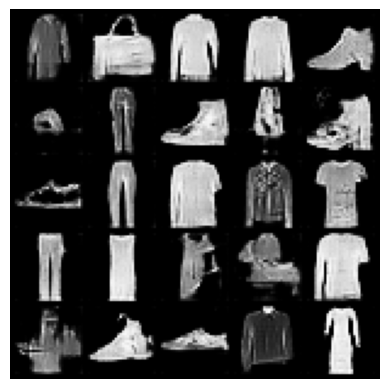

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 127 Step 60000: Gen Loss: 4.1851, Crit Loss: 0.9236


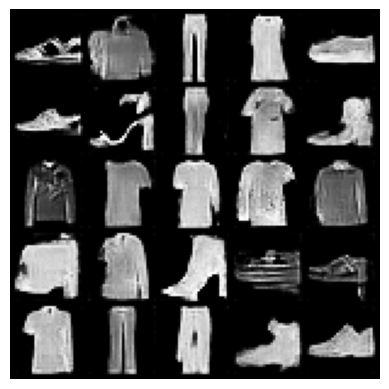

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 128 Step 60500: Gen Loss: 1.8718, Crit Loss: -0.4974


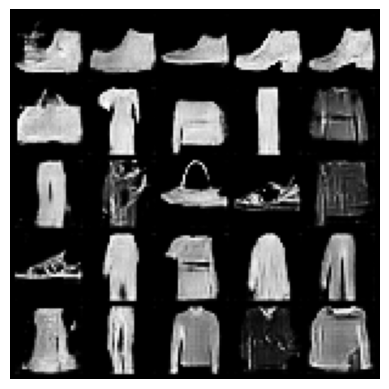

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 130 Step 61000: Gen Loss: 8.4616, Crit Loss: -10.4328


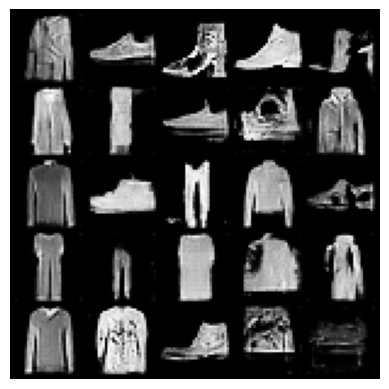

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 131 Step 61500: Gen Loss: 1.9053, Crit Loss: 1.2016


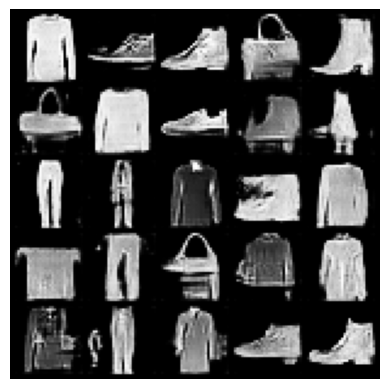

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 132 Step 62000: Gen Loss: 1.2856, Crit Loss: -0.2220


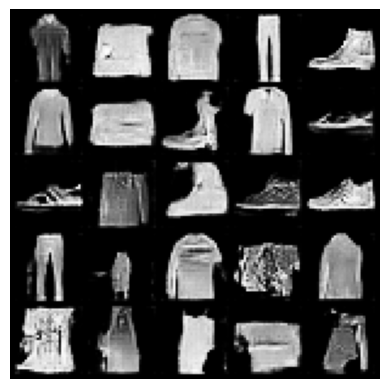

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 133 Step 62500: Gen Loss: 2.8264, Crit Loss: -4.1574


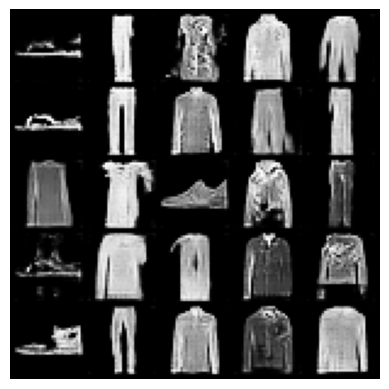

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 134 Step 63000: Gen Loss: -0.1834, Crit Loss: 0.5704


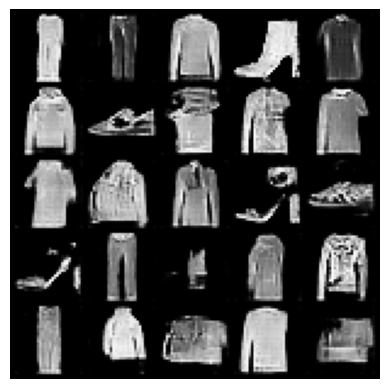

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 135 Step 63500: Gen Loss: 1.6936, Crit Loss: 2.8277


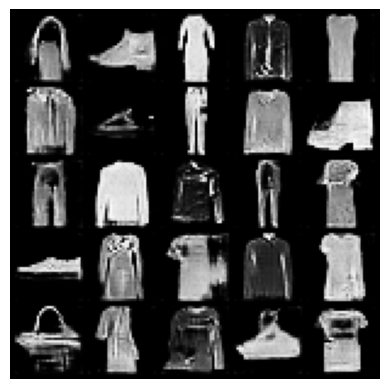

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 136 Step 64000: Gen Loss: 1.2342, Crit Loss: -0.6565


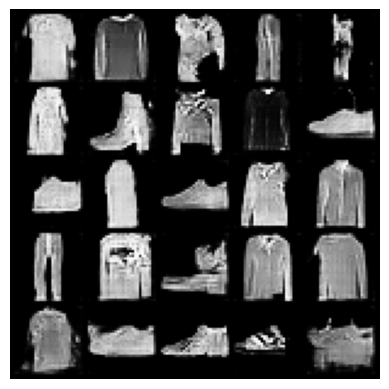

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 137 Step 64500: Gen Loss: 0.8257, Crit Loss: -1.5888


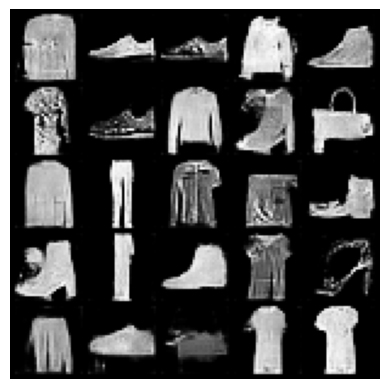

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 138 Step 65000: Gen Loss: 4.0775, Crit Loss: 0.1525


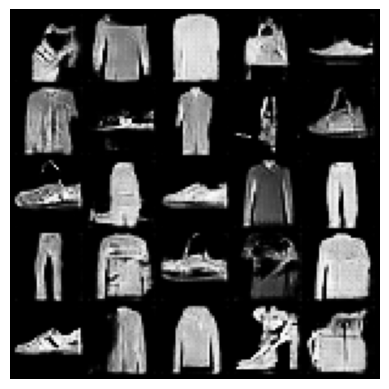

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 139 Step 65500: Gen Loss: 1.2330, Crit Loss: -0.1788


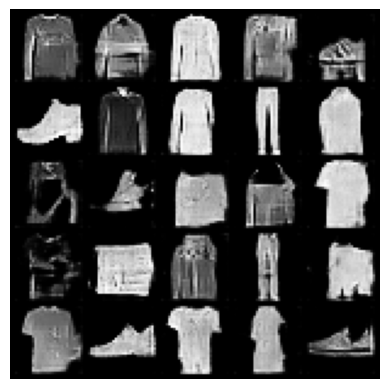

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 140 Step 66000: Gen Loss: 2.9549, Crit Loss: -0.0260


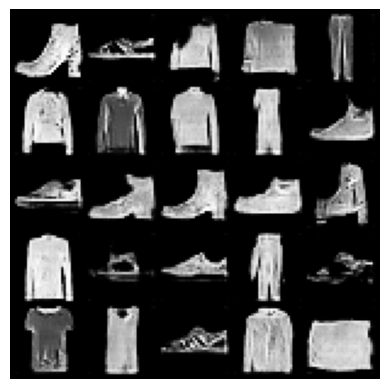

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 141 Step 66500: Gen Loss: 3.1817, Crit Loss: -4.2650


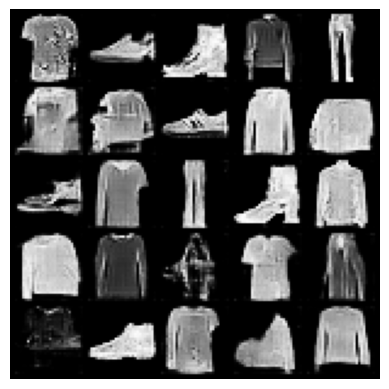

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 142 Step 67000: Gen Loss: -1.2644, Crit Loss: 1.0083


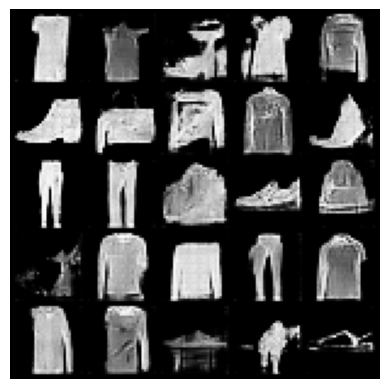

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 143 Step 67500: Gen Loss: -0.1915, Crit Loss: -0.0530


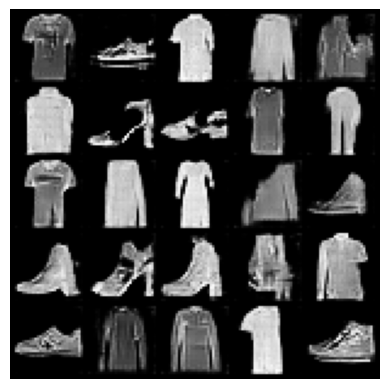

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 144 Step 68000: Gen Loss: 3.3063, Crit Loss: -1.2248


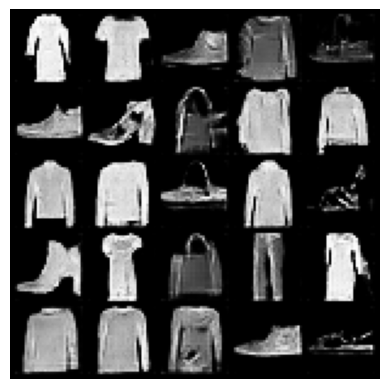

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 146 Step 68500: Gen Loss: 2.1045, Crit Loss: 0.3198


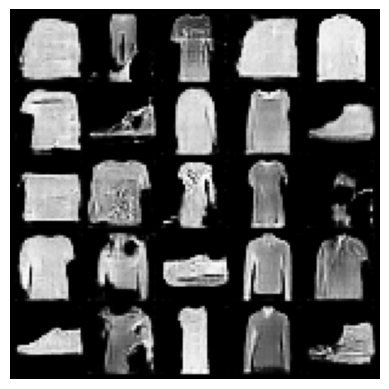

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 147 Step 69000: Gen Loss: 0.2165, Crit Loss: 0.1617


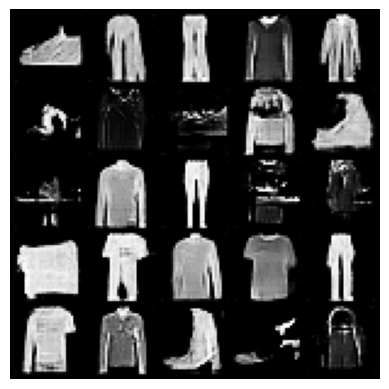

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 148 Step 69500: Gen Loss: 0.1950, Crit Loss: -0.3222


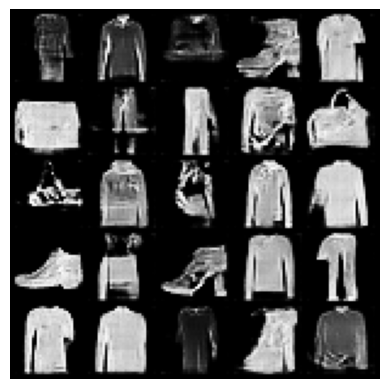

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 149 Step 70000: Gen Loss: -0.1152, Crit Loss: 7.1862


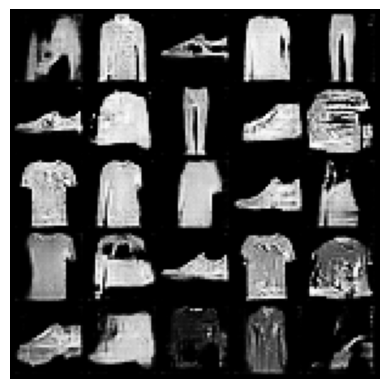

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 150 Step 70500: Gen Loss: 1.6864, Crit Loss: -0.0376


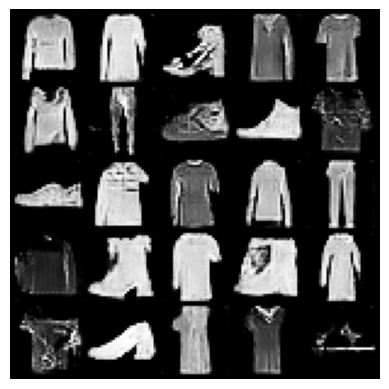

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 151 Step 71000: Gen Loss: 2.2471, Crit Loss: -0.8218


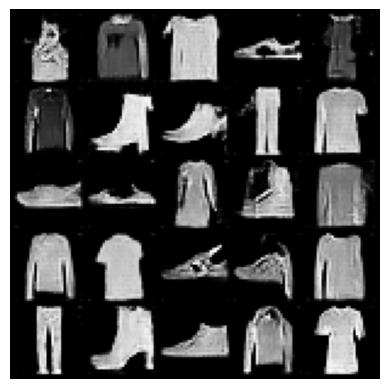

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 152 Step 71500: Gen Loss: 2.4727, Crit Loss: -2.0934


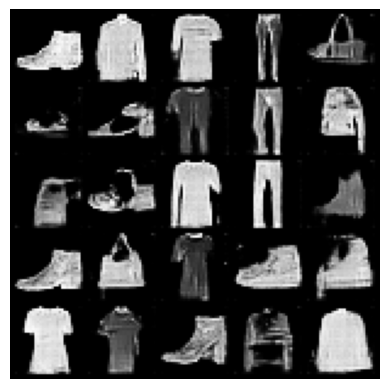

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 153 Step 72000: Gen Loss: 1.8441, Crit Loss: -0.2014


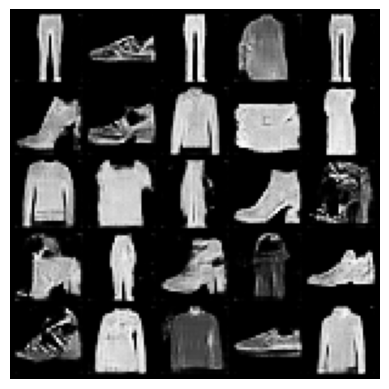

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 154 Step 72500: Gen Loss: -0.4060, Crit Loss: -0.9376


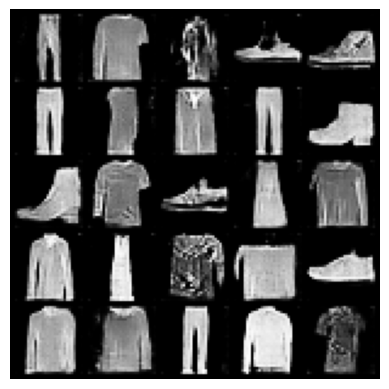

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 155 Step 73000: Gen Loss: 3.4005, Crit Loss: 0.7038


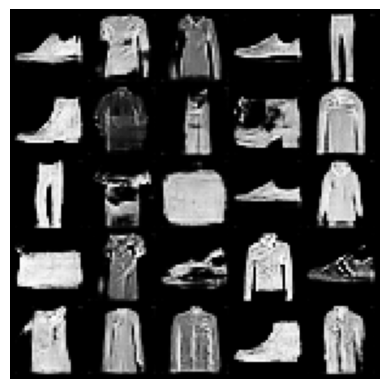

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 156 Step 73500: Gen Loss: 2.1067, Crit Loss: 0.0366


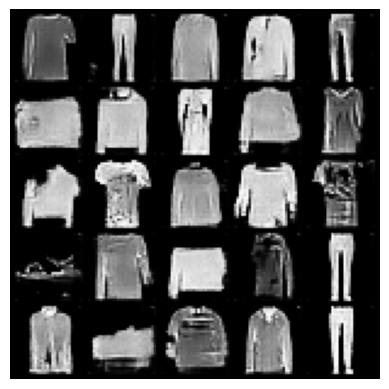

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 157 Step 74000: Gen Loss: 3.7866, Crit Loss: -0.0909


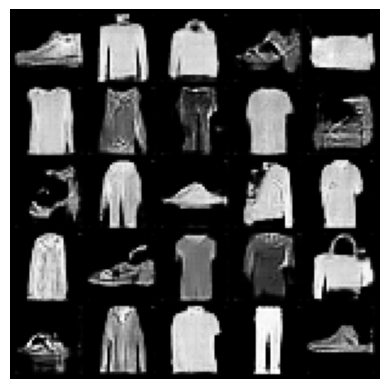

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 158 Step 74500: Gen Loss: 1.7781, Crit Loss: 0.2771


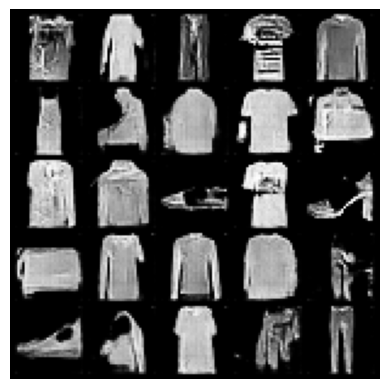

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 159 Step 75000: Gen Loss: 0.9427, Crit Loss: -0.3698


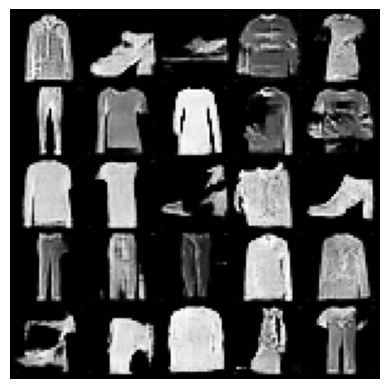

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 160 Step 75500: Gen Loss: 0.7132, Crit Loss: -0.1304


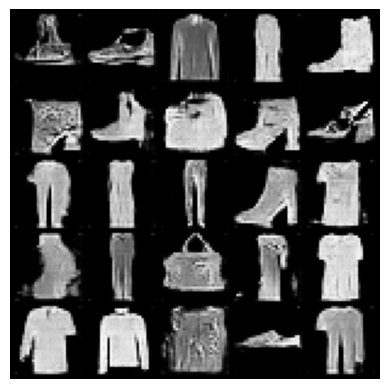

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 162 Step 76000: Gen Loss: 3.8018, Crit Loss: -0.5053


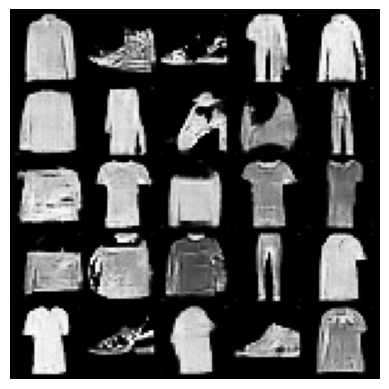

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 163 Step 76500: Gen Loss: 4.5086, Crit Loss: 1.2116


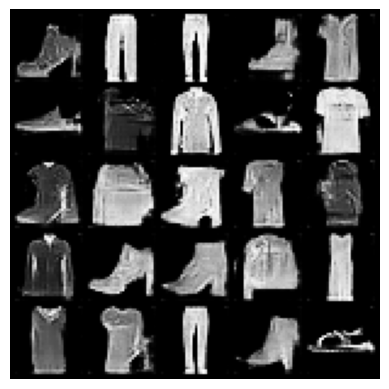

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 164 Step 77000: Gen Loss: -0.5551, Crit Loss: -1.3378


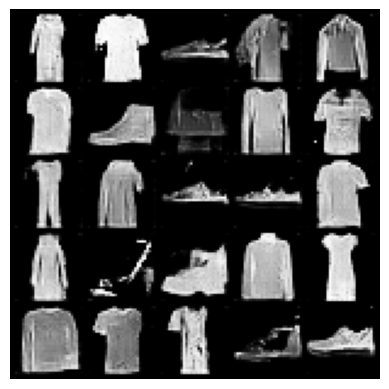

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 165 Step 77500: Gen Loss: 1.2889, Crit Loss: -0.7807


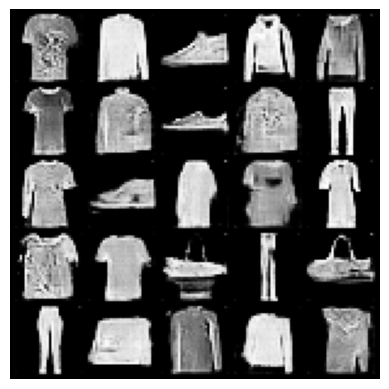

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 166 Step 78000: Gen Loss: 1.5360, Crit Loss: -1.3735


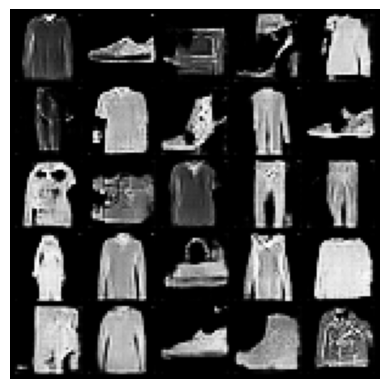

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 167 Step 78500: Gen Loss: 0.1901, Crit Loss: -4.2693


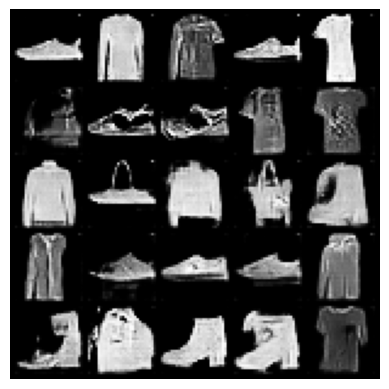

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 168 Step 79000: Gen Loss: 2.3117, Crit Loss: -4.3769


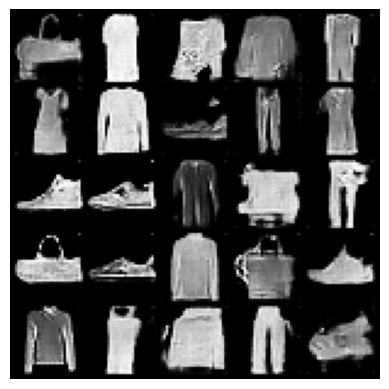

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 169 Step 79500: Gen Loss: -2.9541, Crit Loss: 0.5461


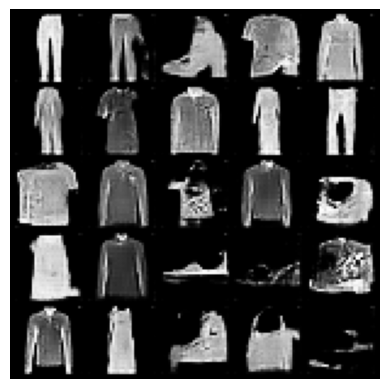

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 170 Step 80000: Gen Loss: 0.5254, Crit Loss: -0.3969


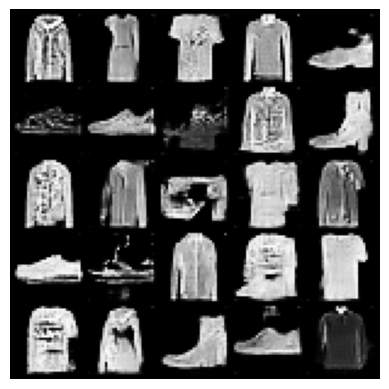

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 171 Step 80500: Gen Loss: 2.6059, Crit Loss: 0.1938


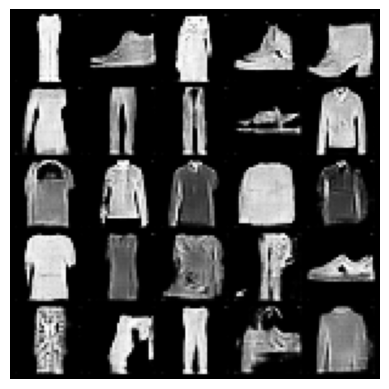

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 172 Step 81000: Gen Loss: 3.2630, Crit Loss: -1.1843


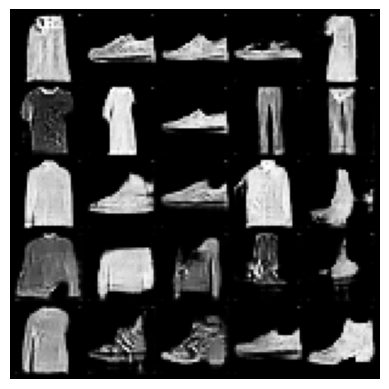

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 173 Step 81500: Gen Loss: 2.6266, Crit Loss: 0.3481


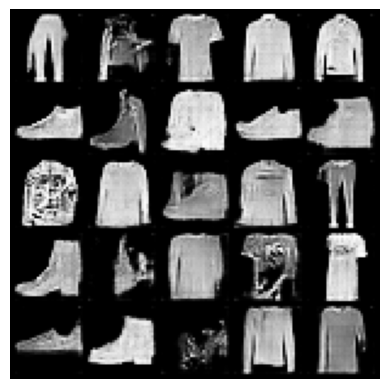

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 174 Step 82000: Gen Loss: 1.8350, Crit Loss: 0.2295


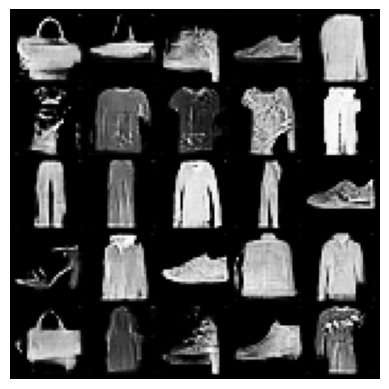

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 175 Step 82500: Gen Loss: 5.9188, Crit Loss: -1.0183


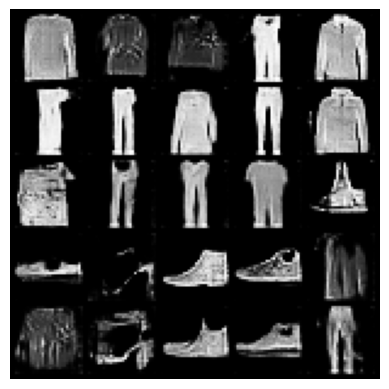

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 176 Step 83000: Gen Loss: 3.5855, Crit Loss: -0.6181


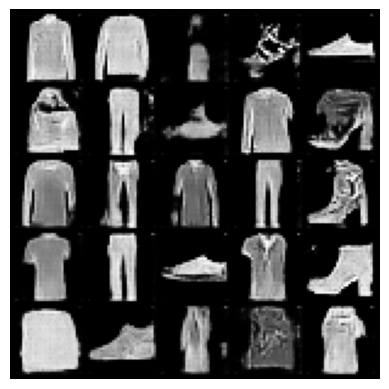

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 178 Step 83500: Gen Loss: 0.1481, Crit Loss: 0.1057


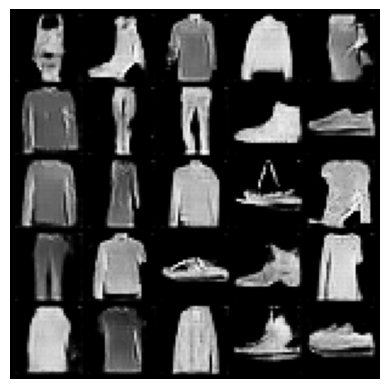

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 179 Step 84000: Gen Loss: 8.3194, Crit Loss: -2.1829


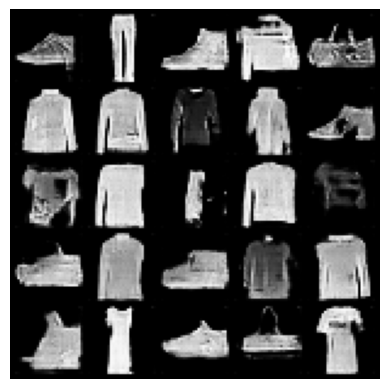

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 180 Step 84500: Gen Loss: 1.6916, Crit Loss: -2.7373


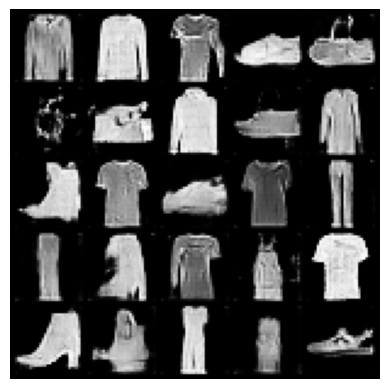

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 181 Step 85000: Gen Loss: 12.8363, Crit Loss: -10.8961


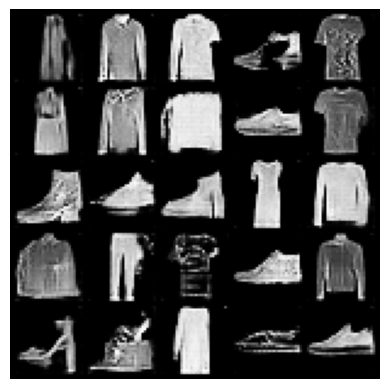

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 182 Step 85500: Gen Loss: -0.8717, Crit Loss: -5.9631


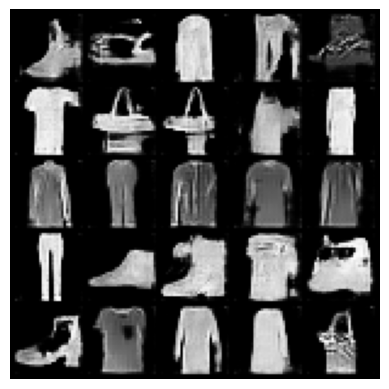

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 183 Step 86000: Gen Loss: -0.2435, Crit Loss: -0.3878


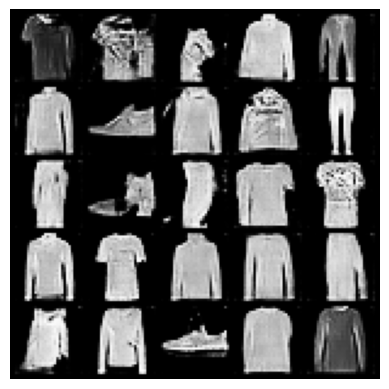

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 184 Step 86500: Gen Loss: 12.4586, Crit Loss: -7.7536


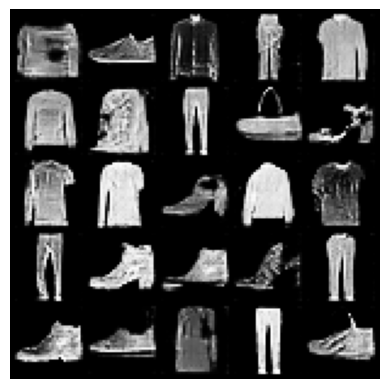

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 185 Step 87000: Gen Loss: -1.3887, Crit Loss: 0.6437


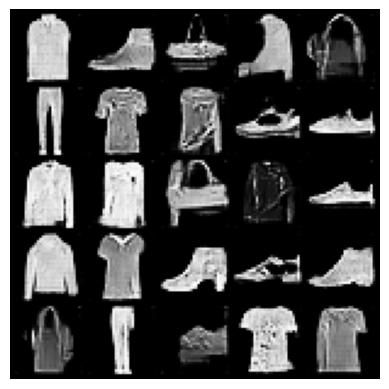

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 186 Step 87500: Gen Loss: 0.9702, Crit Loss: -0.2524


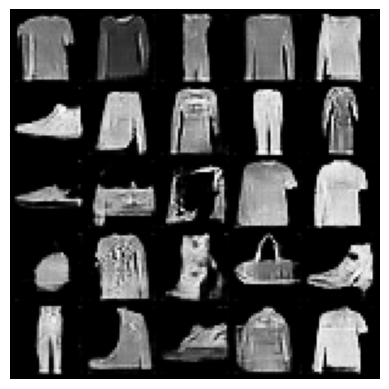

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 187 Step 88000: Gen Loss: -0.6496, Crit Loss: -0.4757


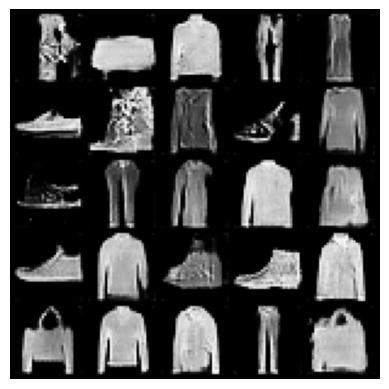

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 188 Step 88500: Gen Loss: 0.3686, Crit Loss: -0.1180


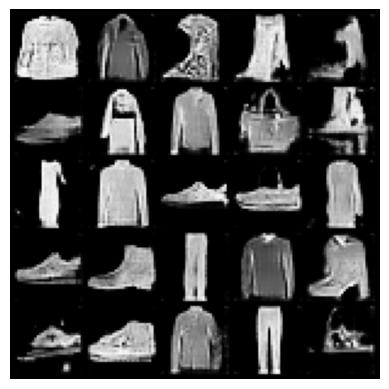

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 189 Step 89000: Gen Loss: -2.1533, Crit Loss: 0.0618


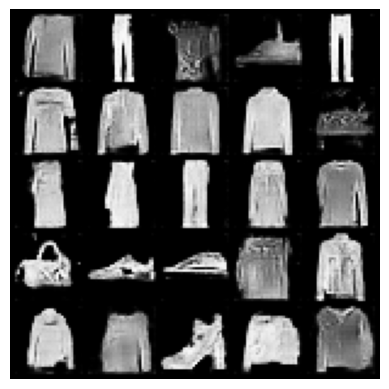

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 190 Step 89500: Gen Loss: 1.3265, Crit Loss: -0.4104


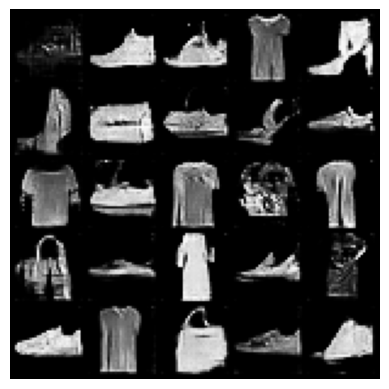

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 191 Step 90000: Gen Loss: -1.4118, Crit Loss: -0.8429


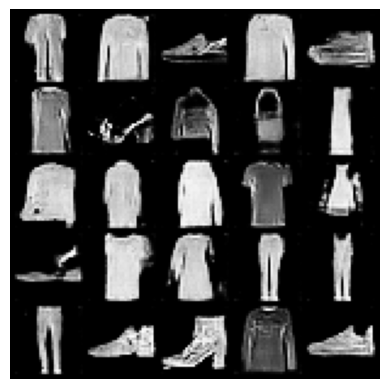

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 192 Step 90500: Gen Loss: 3.3421, Crit Loss: -2.6926


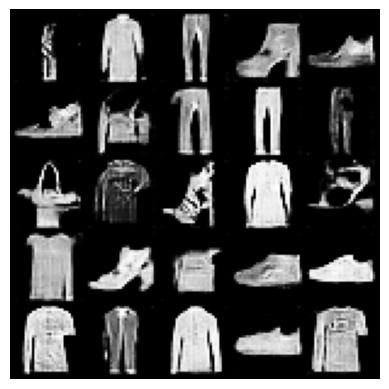

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 194 Step 91000: Gen Loss: -1.1161, Crit Loss: -0.6747


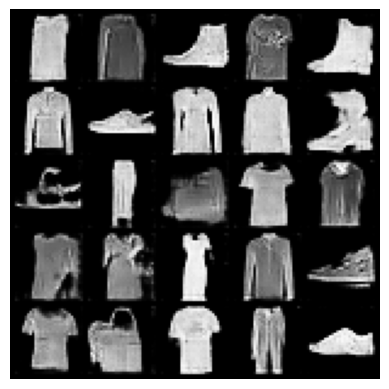

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 195 Step 91500: Gen Loss: -1.8983, Crit Loss: -1.0720


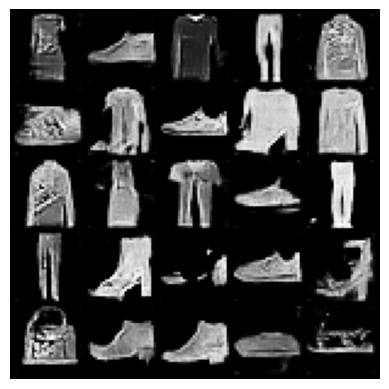

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 196 Step 92000: Gen Loss: -2.3513, Crit Loss: 0.0456


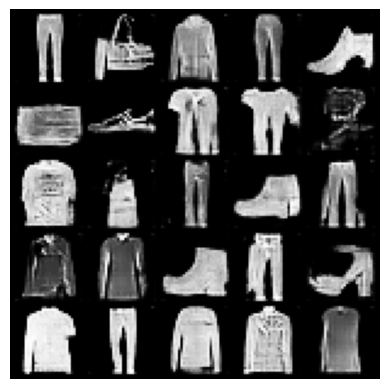

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 197 Step 92500: Gen Loss: -5.1730, Crit Loss: 0.4300


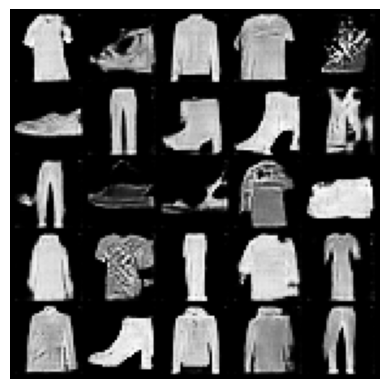

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 198 Step 93000: Gen Loss: -1.4742, Crit Loss: -0.2320


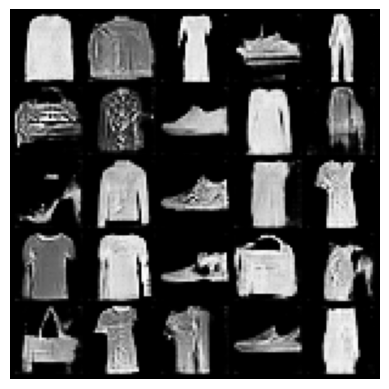

  0%|          | 0/469 [00:00<?, ?it/s]

Epoch 199 Step 93500: Gen Loss: -1.5729, Crit Loss: -0.6465


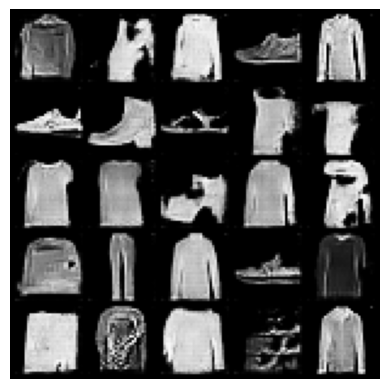

In [11]:
# Step 11: Training Loop
cur_step = 0
crit_losses = []
gen_losses = []

for epoch in range(n_epochs):
    for real, _ in tqdm(dataloader):
        real = real.to(device)
        cur_batch_size = len(real)

        # Critic training loop
        mean_crit_loss = 0
        for _ in range(crit_repeats):
            crit_opt.zero_grad()
            noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(noise)

            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)
            epsilon = torch.rand(cur_batch_size, 1, 1, 1, device=device, requires_grad=True)
            grad = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(grad)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)
            crit_loss.backward(retain_graph=True)
            crit_opt.step()
            mean_crit_loss += crit_loss.item() / crit_repeats

        crit_losses.append(mean_crit_loss)

        # Generator training step
        gen_opt.zero_grad()
        noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(noise)
        crit_fake_pred = crit(fake)
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()
        gen_opt.step()
        gen_losses.append(gen_loss.item())

        # Display progress
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch} Step {cur_step}: Gen Loss: {gen_loss.item():.4f}, Crit Loss: {mean_crit_loss:.4f}")
            show_tensor_images(fake)

        cur_step += 1


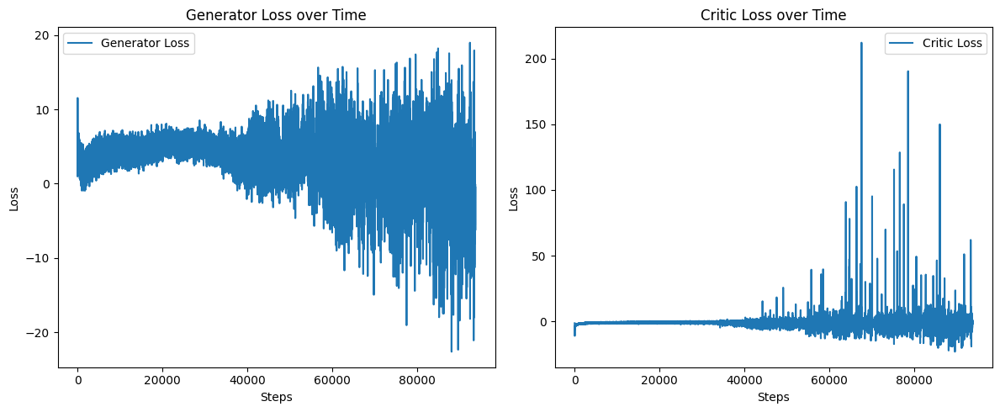

In [12]:
# Step 12: Plot Final Loss Curves
plt.figure(figsize=(12,5))
plt.subplot(1, 2, 1)
plt.plot(gen_losses, label='Generator Loss')
plt.title('Generator Loss over Time')
plt.xlabel('Steps')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(crit_losses, label='Critic Loss')
plt.title('Critic Loss over Time')
plt.xlabel('Steps')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()
